# **Single Object Tracking-Group13**

In our pursuit of rеfining mеthodologiеs for Singlе Objеct Tracking (SOT) within our projеct, thе intеgration of statе-of-thе-art objеct dеtеction modеls has еmеrgеd as a crucial approach to еnhancе tracking prеcision and еfficiеncy. YOLOv8, thе latеst itеration in thе еstееmеd YOLO sеriеs, stands as a fundamеntal componеnt within our projеct framеwork, еlеvating thе capabilitiеs of objеct localization and tracking. [1]




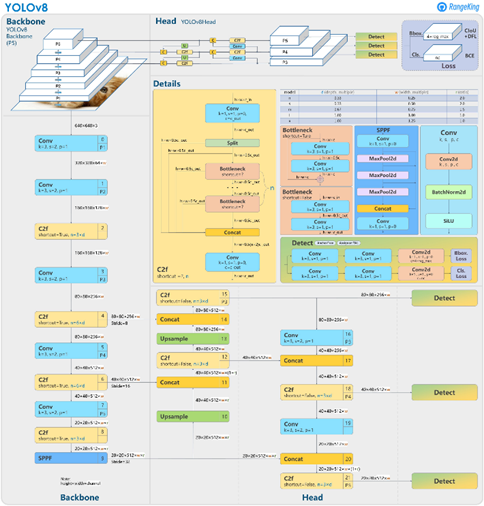

Our project aims to harnеss the strengths of YOLOv8, which has been meticulously crafted and optimized for object detection tasks, to apply thеsе advancements in the context of Single Object Tracking. With its advanced architecture and dеvеlopеr-friеndly attributes, YOLOv8 holds the potential to significantly enhance our project’s SOT capabilities.
This paper serves as an extensive exploration and evaluation of thе integration of YOLOv8 within our project’s Single Object Tracking framework. We delve dееp into thе intricacies of incorporating YOLOv8's object detection expertise to improve object tracking across video frames, highlighting thе tailored features and modifications implemented to align with our specific tracking requirements.
Furthermore, our study delves into thе practical aspects of utilizing YOLOv8 within our project, assessing its adaptability, accuracy, and computational efficiency in various tracking scenarios encountered within our application domain. Through empirical evaluations and comparisons with existing methodologies employed in our project, our goal is to shed light on thе impact of YOLOv8 integration on thе overall SOT performance metrics.
This paper encapsulates our project’s journey in utilizing YOLOv8 for Single Object Tracking, providing insights into thе implementation, adaptability, and effectiveness of this cutting-edge object detection model within our specific application context. Our findings aim to contribute not only to thе enhancement of our project’s SOT capabilities, but also to a broader understanding of utilizing YOLOv8 in real-world tracking scenarios.

#Import Dependencies

In [ ]:
!pip install flow_vis

In [ ]:
!pip install package_name

  Preparing metadata (setup.py) ... done
  Created wheel for package_name: filename=package_name-0.1-py3-none-any.whl size=1232 sha256=9ae92b46d7eb3994e6cc929f9b9d0488de6bcac59ce84785364da6a558f66a2d
  Stored in directory: /root/.cache/pip/wheels/a3/36/c4/98d928f30290fb88555f848f73093f02b67c984a45c56c3e97
Successfully built package_name


In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 646.6/646.6 kB 10.7 MB/s eta 0:00:00


In [ ]:

import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import pandas as pd
import cv2

from google.colab import drive
from sklearn.model_selection import train_test_split
from pkg_resources import parse_version

import datetime
from google.colab.patches import cv2_imshow
from statistics import mean

# Maybe use flowpy instead which can read/write png and flo files in KITTI and Middleburry format respectively.
import matplotlib.patches as patches
import matplotlib
import matplotlib.pyplot as plt

# Tensorflow ≥2.0 is required
import tensorflow as tf
import tensorflow_datasets as tfds


# Python ≥3.5 is required
import sys
assert sys.version_info >= (3,5)

# flow_vis library implements Middlebury flow vector coloring
import flow_vis
import yaml

from PIL import Image
from ultralytics import YOLO
import subprocess
from IPython.display import HTML
from base64 import b64encode

Accessing the drive where the dataset was uploaded.

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
dummy = tf.constant( 32 )
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


#Helper Functions

In [ ]:
def reset_seed(seed=42):
    np.random.seed(seed)
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
if 'google.colab' in str(get_ipython()):
  print('Running on CoLab')
  from google.colab import drive

  drive.mount('/content/drive')

  #PROJECT_ROOT_DIR = "/content/drive/MyDrive/Colab Notebooks/CV/data/tensorflow_data"
  PROJECT_ROOT_DIR = "/content/drive/MyDrive/CV"
else:
  print('Not running on CoLab')
  PROJECT_ROOT_DIR = os.getcwd()

NB_ID = "project"


Running on CoLab
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

###Preprocessing

 `process_data`function takes three inputs: `train_data` (containing video information), `class_name` (a string representing the class), and `video_num` (an integer representing the video number).

The function processes each frame in the video, extracts bounding box information for instances of a specific category (category 14 in this case), and creates a dictionary (`dic`) with keys 'image', 'target', and 'image_path'.

For each frame, it extracts the image, relevant target bounding box coordinates, and constructs an image path. The resulting dictionary contains lists of images, corresponding target bounding box information, and image paths.

The function returns this dictionary as its output. Overall, it facilitates the extraction and organization of data from video frames for further processing or analysis.

In [ ]:
IDcounts = {int(i): 0 for i in range(17)}

def process_data(train_data, class_name, video_num):
    dic = {'image': [], 'target': [], 'image_path': []}
    num_frames = int(train_data['metadata']['num_frames'])
    resolution = [train_data['metadata']['height'], train_data['metadata']['width']]
    folder_name = class_name + "_video_" + str(video_num)

    for i in range(num_frames):
        target = []
        category = []
        image = train_data['video'][i, :, :, :]
        segmentation = train_data['segmentations'][i, :, :, :].numpy()
        for id in range(train_data['instances']['bbox_frames'].shape[0]):
            if i in train_data['instances']['bbox_frames'][id]:
                t = find_index(train_data['instances']['bbox_frames'][id], i)
                item = train_data['instances']['bboxes'][id, t, :]

                y_min = int(item[0] * float(resolution[0]))
                x_min = int(item[1] * float(resolution[1]))
                y_max = int(item[2] * float(resolution[0]))
                x_max = int(item[3] * float(resolution[1]))
                category = train_data["instances"]["category"][id].numpy()
                # Increment the count for the category
                IDcounts[int(category)] += 1

                target.append([y_min, x_min, y_max, x_max, category])

        image_path = f"{folder_name}_image_{i}"
        dic['image'].append(image.numpy())
        dic['target'].append(target)
        dic['image_path'].append(image_path)

    return dic


`find_index` function searches for the index of a specified element (`id`) within a given list or array (`input`). It iterates through the elements, returning the index of the first occurrence of the specified element. If the element is not found, the function returns `None`. The `break` statement after the `return` is unnecessary as `return` exits the function immediately.

In [ ]:
def find_index(input, id):
    for i in range(len(input)):
        if input[i] == id:
            return i
            break

###Normalization

`normalize_bbox` function takes a bounding box (`box`) and the shape of the corresponding image (`image_shape`) as input. It normalizes the bounding box coordinates by calculating the center coordinates (`x_center` and `y_center`), width (`width`), and height (`height`) relative to the dimensions of the image. The function then returns these normalized values along with the category information from the original bounding box (`box`).

In [ ]:
# Function to normalize the bounding boxes
def normalize_bbox(box, image_shape):
    y_min, x_min, y_max, x_max = box[0:4]
    x_center = (x_min + x_max) / (2 * image_shape[1])
    y_center = (y_min + y_max) / (2 * image_shape[0])
    width = (x_max - x_min) / image_shape[1]
    height = (y_max - y_min) / image_shape[0]
    return x_center, y_center, width, height, box[4]

###Show Multiple Object

`plot_images_with_Multiple_bbox(dataframe)`funtion creates a visual representation of images with multiple bounding boxes. It uses a Pandas DataFrame containing image and bounding box information, arranging the images in a grid of subplots. Bounding boxes are drawn on each image, displayed in a red rectangle, providing a clear visualization of object localization. The function adjusts the layout to accommodate varying numbers of images and removes unnecessary subplots, resulting in an organized and informative visual summary.

In [ ]:
def plot_images_with_Multiple_bbox(dataframe):
    num_images = len(dataframe)
    rows = (num_images + 3) // 4  # Calculate the number of rows for subplots
    fig, axes = plt.subplots(rows, 4, figsize=(12, 3 * rows))
    axes = axes.ravel()

    for idx, (_, row) in enumerate(dataframe.iterrows()):
        image = np.array(row['image'])
        targets = row['target']

        ax = axes[idx]
        ax.imshow(image)

        for target in targets:
            y, x, height, width, obj_id = target  # Extract object ID
            rect = patches.Rectangle((x, y), width - x, height - y, linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

            # Display object ID above the bounding box
            ax.text(x, y - 5, str(obj_id), color='r', fontsize=12, fontweight='bold')

        ax.axis('off')

    # Remove any empty subplots
    for i in range(num_images, rows * 4):
        fig.delaxes(axes[i])

    plt.tight_layout()
    plt.show()


###Filter data by Object ID

`filter_lists_by_objectTrackID` function processes a DataFrame containing image-related information. It filters rows based on whether the 'target' column in each row includes lists with a specified `objectTrackID` as their last element. The function creates a new DataFrame with the filtered rows, excluding those that do not meet the criteria. The resulting DataFrame, named `new_df`, contains only rows where the 'target' column has lists ending with the specified `objectTrackID`.

In [ ]:
def filter_lists_by_objectTrackID(df, objectTrackID):
    new_data = {'image': [], 'target': [], 'image_path': [], 'VideoID': [], 'ImageID': [], 'Class': []}

    for _, row in df.iterrows():
        targets = row['target']
        filtered_lists = []

        # Iterate over each list in the 'target' column
        for target_list in targets:
            # Check if the last number in the list matches the specified 'objectTrackID'
            if target_list[-1] == objectTrackID:
                filtered_lists.append(target_list)


        # Check if the filtered lists are not empty before adding the row to the new DataFrame
        if filtered_lists:
            new_data['image'].append(row['image'])
            new_data['target'].append(filtered_lists)
            new_data['image_path'].append(row['image_path'])
            new_data['VideoID'].append(row['VideoID'])
            new_data['ImageID'].append(row['ImageID'])
            new_data['Class'].append(row['Class'])

    # Create a new DataFrame with the filtered 'target' column
    new_df = pd.DataFrame(new_data)

    return new_df

#Data Preprocessing

Dataset

---


The dataset utilized in this study is specialized for object detection and tracking tasks, comprising three distinct classes of images: 'linear_movement_rotate', 'rotation_rotate', and 'fixed_random_rotate'.

 Each class encapsulates 30 videos, showcasing diverse variations in object movement or rotation characteristics.
Comprising video sequences with 24 frames per video, each frame delineates 16 individual objects exhibiting a spectrum of movement types—rotational, linear, or fixed random rotations. Notably, each image within the dataset can feature multiple objects, and the same object may appear across different frames.
The dataset schema encompasses the last 2160 rows (frames) and 6 columns, providing detailed information:
* 'Image' (RGB): Represents image pixels in a 3-D format.
* 	'Target' (Bounding boxes and IDs for each object within the frame): Includes annotations comprising bounding box coordinates (formatted as y_min, x_min, y_max, x_max) defining object spatial extents and unique identifiers (Object IDs) for each detected object.
* 'Image Paths': Specifies paths denoting the location of each image within the dataset.
* 'VideoID' and 'ImageID': Unique identifiers for videos and individual images, facilitating dataset organization and referencing.
*	'Class' (Class Name) Information: Indicates the class to which each frame or object belongs, detailing the specific movement or rotation characteristic


The provided code loads image data from different classes ('linear_movement_rotate', 'rotation_rotate', 'fixed_random_rotate') using TensorFlow Datasets (tfds). It then processes each video in the dataset using the `process_data` function, extracting relevant information such as images, targets, video IDs, and image IDs. The processed data is stored in a Pandas DataFrame named `df`, which consolidates information from all classes. The DataFrame includes columns for images, targets, image paths, video IDs, image IDs, and class labels.

In [ ]:
data_path = os.path.join(PROJECT_ROOT_DIR)
class_names = ["fixed_random_rotate","linear_movement_rotate", "rotation_rotate" ]
class_data_frames = []

for class_name in class_names:
    data_frame = {'image': [], 'target': [], 'image_path': [], 'VideoID': [], 'ImageID': [], 'Class': []}
    class_data = tfds.load(f'elg7186_projectdata/{class_name}', data_dir=data_path)

    for video_num, video_data in enumerate(class_data['train']):
        dic = process_data(video_data, class_name, video_num)
        video_id = video_num  # Extracting only the number from the video ID
        for i, img_path in enumerate(dic['image_path']):
            image_id = i  # Extracting only the number from the image ID
            data_frame['image'].append(dic['image'][i])
            data_frame['target'].append(dic['target'][i])
            data_frame['image_path'].append(img_path)
            data_frame['VideoID'].append(video_id)
            data_frame['ImageID'].append(image_id)
            data_frame['Class'].append(class_name)

    df_class_data = pd.DataFrame(data_frame)
    class_data_frames.append(df_class_data)

# Combine data frames of all classes
df = pd.concat(class_data_frames, ignore_index=True)
df

,image,target,image_path,VideoID,ImageID,Class
0,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[74, 103, 129, 178, 13], [67, 80, 108, 130, 6...",fixed_random_rotate_video_0_image_0,0,0,fixed_random_rotate
1,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[76, 104, 128, 178, 13], [67, 84, 89, 132, 6]...",fixed_random_rotate_video_0_image_1,0,1,fixed_random_rotate
2,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[77, 104, 129, 179, 13], [68, 87, 89, 132, 6]...",fixed_random_rotate_video_0_image_2,0,2,fixed_random_rotate
3,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[79, 104, 129, 180, 13], [68, 89, 90, 132, 6]...",fixed_random_rotate_video_0_image_3,0,3,fixed_random_rotate
4,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[83, 103, 129, 182, 13], [69, 89, 94, 132, 6]...",fixed_random_rotate_video_0_image_4,0,4,fixed_random_rotate
...,...,...,...,...,...,...
2155,"[[[180, 75, 46], [174, 73, 47], [165, 68, 43],...","[[88, 87, 147, 146, 6], [85, 68, 147, 143, 16]...",rotation_rotate_video_29_image_19,29,19,rotation_rotate
2156,"[[[194, 87, 54], [193, 86, 54], [193, 84, 53],...","[[88, 94, 146, 142, 6], [87, 70, 144, 138, 16]...",rotation_rotate_video_29_image_20,29,20,rotation_rotate
2157,"[[[194, 89, 51], [194, 89, 51], [194, 89, 51],...","[[89, 102, 144, 137, 6], [85, 74, 144, 138, 16...",rotation_rotate_video_29_image_21,29,21,rotation_rotate
2158,"[[[188, 84, 49], [188, 85, 49], [191, 87, 51],...","[[88, 103, 144, 143, 6], [82, 69, 144, 139, 16...",rotation_rotate_video_29_image_22,29,22,rotation_rotate


##Show Images

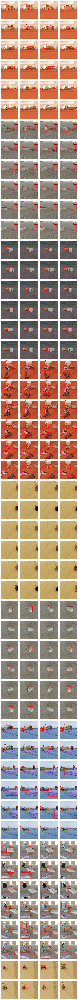

In [ ]:
plot_images_with_Multiple_bbox(df[0:200])

##Object Counts

In [ ]:
# Sort the dictionary based on values in descending order
sorted_IDcounts = dict(sorted(IDcounts.items(), key=lambda item: item[1], reverse=True))

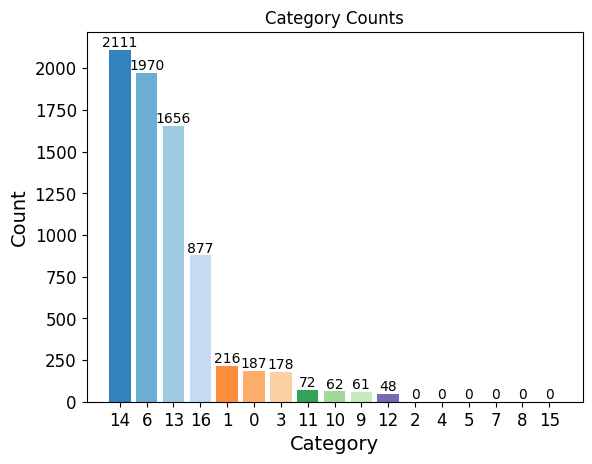

In [ ]:
# Convert keys to strings
IDcounts_str_keys = {str(key): value for key, value in IDcounts.items()}
sorted_IDcounts = dict(sorted(IDcounts_str_keys.items(), key=lambda item: item[1], reverse=True))

categories = list(sorted_IDcounts.keys())
counts = list(sorted_IDcounts.values())

colors = plt.cm.tab20c(np.linspace(0, 1, len(categories)))  # Use 'YlGnBu' colormap here
bars = plt.bar(categories, counts, color=colors)

plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Category Counts')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, round(yval), ha='center', va='bottom')

plt.show()


#Select Object

I.	Object Selection and Normalization:

---

Thе dataset preprocessing primarily focuses on isolating objects identified by thе specific ID 14, specifically categorized as 'Shoe' Subsequently, a newly introduced feature, named 'normalizе_targеt,' details thе normalized bounding box coordinates specific to this designated object.


In [ ]:
objectTrackID=14

In [ ]:
new_df = filter_lists_by_objectTrackID(df, objectTrackID)
new_df

,image,target,image_path,VideoID,ImageID,Class
0,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[118, 107, 127, 116, 14]]",fixed_random_rotate_video_0_image_0,0,0,fixed_random_rotate
1,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[118, 112, 127, 122, 14]]",fixed_random_rotate_video_0_image_1,0,1,fixed_random_rotate
2,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[118, 114, 127, 124, 14]]",fixed_random_rotate_video_0_image_2,0,2,fixed_random_rotate
3,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[117, 114, 127, 125, 14]]",fixed_random_rotate_video_0_image_3,0,3,fixed_random_rotate
4,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[116, 113, 127, 125, 14]]",fixed_random_rotate_video_0_image_4,0,4,fixed_random_rotate
...,...,...,...,...,...,...
1089,"[[[19, 19, 23], [23, 23, 27], [25, 25, 29], [2...","[[118, 79, 145, 125, 14]]",rotation_rotate_video_28_image_19,28,19,rotation_rotate
1090,"[[[36, 36, 39], [39, 41, 45], [35, 36, 42], [3...","[[118, 76, 143, 123, 14]]",rotation_rotate_video_28_image_20,28,20,rotation_rotate
1091,"[[[76, 66, 63], [93, 82, 72], [100, 92, 89], [...","[[118, 72, 143, 121, 14]]",rotation_rotate_video_28_image_21,28,21,rotation_rotate
1092,"[[[90, 99, 81], [84, 88, 62], [93, 100, 83], [...","[[118, 69, 141, 119, 14]]",rotation_rotate_video_28_image_22,28,22,rotation_rotate


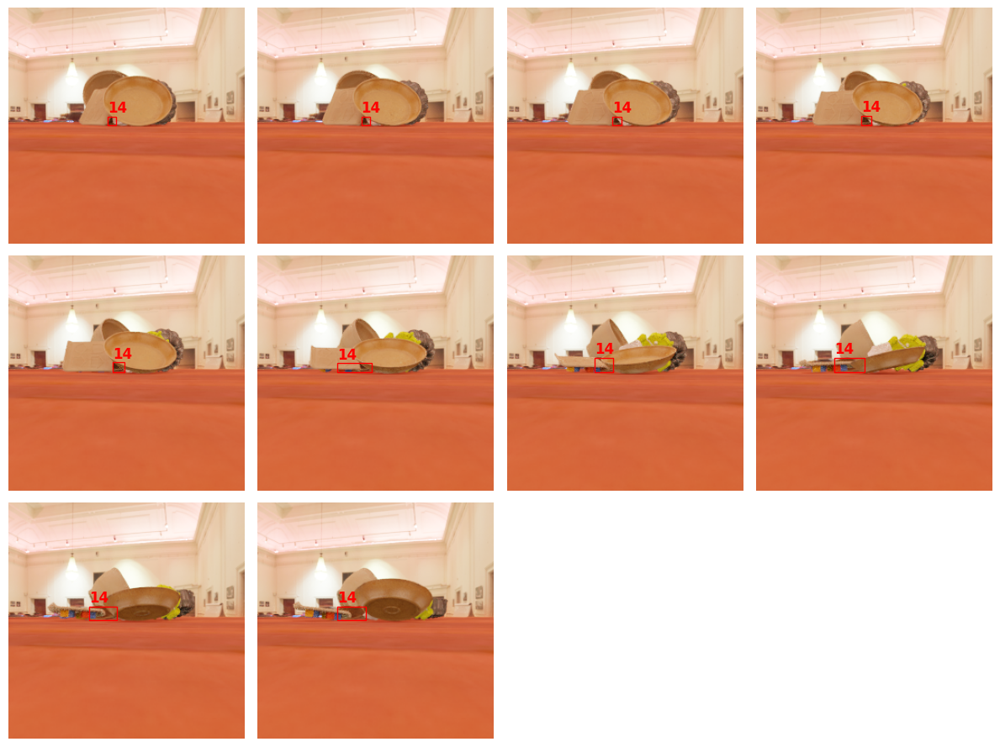

In [ ]:
plot_images_with_Multiple_bbox(new_df[0:10])

##Apply Normalization

In [ ]:
# Applying the function to the 'target' column
image_shape = (256, 256)  # Example image shape
new_df['normalize_target'] = new_df['target'].apply(lambda x: [normalize_bbox(box, image_shape) for box in x])
new_df

,image,target,image_path,VideoID,ImageID,Class,normalize_target
0,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[118, 107, 127, 116, 14]]",fixed_random_rotate_video_0_image_0,0,0,fixed_random_rotate,"[(0.435546875, 0.478515625, 0.03515625, 0.0351..."
1,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[118, 112, 127, 122, 14]]",fixed_random_rotate_video_0_image_1,0,1,fixed_random_rotate,"[(0.45703125, 0.478515625, 0.0390625, 0.035156..."
2,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[118, 114, 127, 124, 14]]",fixed_random_rotate_video_0_image_2,0,2,fixed_random_rotate,"[(0.46484375, 0.478515625, 0.0390625, 0.035156..."
3,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[117, 114, 127, 125, 14]]",fixed_random_rotate_video_0_image_3,0,3,fixed_random_rotate,"[(0.466796875, 0.4765625, 0.04296875, 0.039062..."
4,"[[[238, 200, 175], [235, 199, 171], [234, 199,...","[[116, 113, 127, 125, 14]]",fixed_random_rotate_video_0_image_4,0,4,fixed_random_rotate,"[(0.46484375, 0.474609375, 0.046875, 0.0429687..."
...,...,...,...,...,...,...,...
1089,"[[[19, 19, 23], [23, 23, 27], [25, 25, 29], [2...","[[118, 79, 145, 125, 14]]",rotation_rotate_video_28_image_19,28,19,rotation_rotate,"[(0.3984375, 0.513671875, 0.1796875, 0.1054687..."
1090,"[[[36, 36, 39], [39, 41, 45], [35, 36, 42], [3...","[[118, 76, 143, 123, 14]]",rotation_rotate_video_28_image_20,28,20,rotation_rotate,"[(0.388671875, 0.509765625, 0.18359375, 0.0976..."
1091,"[[[76, 66, 63], [93, 82, 72], [100, 92, 89], [...","[[118, 72, 143, 121, 14]]",rotation_rotate_video_28_image_21,28,21,rotation_rotate,"[(0.376953125, 0.509765625, 0.19140625, 0.0976..."
1092,"[[[90, 99, 81], [84, 88, 62], [93, 100, 83], [...","[[118, 69, 141, 119, 14]]",rotation_rotate_video_28_image_22,28,22,rotation_rotate,"[(0.3671875, 0.505859375, 0.1953125, 0.0898437..."


#Spliting Data (Train,Valdiution)

II.	Data Splitting for Balance:

---
A stratified method is employed to ensure fairness and consistency in thе dataset, adeptly handling frame count variations associated with thе object ID 14 criterion. From each video, 70% of thе frame containing Object 14 are designated for thе training set, while thе remaining 30% are allocated for validation. This class-driven frame division еnsurеs proportional representation across classes, effectively maintaining an unbiased distribution of frames among diverse classes and videos. This systematic strategy upholds thе dataset’s integrity and neutrality, ensuring equitable representation and fairness in model training and evaluation.

###Counts of this Object in each video in the 3 classes

The code generates a DataFrame grouped_counts_df from a grouped Series grouped_counts containing counts per unique combinations of 'Class' and 'VideoID', applying a blue color gradient to visually represent the counts using the background_gradient method in Pandas' Styler.

In [ ]:
grouped_counts = new_df.groupby(['Class', 'VideoID']).size()

# Convert the Series to a DataFrame
grouped_counts_df = grouped_counts.reset_index(name='Count')
grouped_counts_df.style.background_gradient(cmap='Blues')


,Class,VideoID,Count
0,fixed_random_rotate,0,24
1,fixed_random_rotate,3,24
2,fixed_random_rotate,6,24
3,fixed_random_rotate,7,24
4,fixed_random_rotate,9,18
5,fixed_random_rotate,10,24
6,fixed_random_rotate,15,24
7,fixed_random_rotate,17,24
8,fixed_random_rotate,18,24
9,fixed_random_rotate,21,24


###Split Data

The code performs grouping and counting of unique 'Class' and 'VideoID' combinations in the DataFrame `new_df`. It subsequently splits the data into training and validation sets, maintaining the 70-30 ratio for each 'Class' and 'VideoID' group without shuffling. Finally, it stores the segmented sets in `X_train` and `X_valid` DataFrames for further analysis or modeling purposes.

In [ ]:
# Convert the Series to a DataFrame
grouped_counts_df = grouped_counts.reset_index(name='Count')

# Initialize X_train_df and X_valid_df DataFrames
train_df = pd.DataFrame(columns=new_df.columns)
valid_df = pd.DataFrame(columns=new_df.columns)

# Iterating through each group
for idx, row in grouped_counts_df.iterrows():
    class_val, video_id, count = row['Class'], row['VideoID'], row['Count']

    # Get the group based on Class and VideoID
    group = new_df[(new_df['Class'] == class_val) & (new_df['VideoID'] == video_id)]

    # Splitting the group into train and validation sets (70% train, 30% validation) without shuffling
    train_set, valid_set = train_test_split(group, train_size=0.7, shuffle=False, random_state=42)

    # Appending to X_train_df and X_valid_df
    train_df = pd.concat([train_df, train_set])
    valid_df = pd.concat([valid_df, valid_set])

# Resetting index for X_train and X_valid
train_df.reset_index(drop=True, inplace=True)
valid_df.reset_index(drop=True, inplace=True)

###Spliting according to video and its frames count in each class

In [ ]:
grouped_counts_X_train = train_df.groupby(['Class', 'VideoID']).size().reset_index(name='Count')
grouped_counts_X_valid = valid_df.groupby(['Class', 'VideoID']).size().reset_index(name='Count')

grouped_counts_df_all = grouped_counts_df.merge(grouped_counts_X_train.groupby(['Class', 'VideoID'])['Count'].last().reset_index(),
                                            on=['Class', 'VideoID'], how='left', suffixes=('', '_train'))

grouped_counts_df_all = grouped_counts_df_all.merge(grouped_counts_X_valid.groupby(['Class', 'VideoID'])['Count'].last().reset_index(),
                                            on=['Class', 'VideoID'], how='left', suffixes=('', '_valid'))

grouped_counts_df_all.style.background_gradient(cmap='Blues')

,Class,VideoID,Count,Count_train,Count_valid
0,fixed_random_rotate,0,24,16,8
1,fixed_random_rotate,3,24,16,8
2,fixed_random_rotate,6,24,16,8
3,fixed_random_rotate,7,24,16,8
4,fixed_random_rotate,9,18,12,6
5,fixed_random_rotate,10,24,16,8
6,fixed_random_rotate,15,24,16,8
7,fixed_random_rotate,17,24,16,8
8,fixed_random_rotate,18,24,16,8
9,fixed_random_rotate,21,24,16,8


In [ ]:
# Assuming 'train_data' and 'valid_data' are your DataFrames

# Selecting all features except the last one for X_train and X_valid
X_train = train_df[["image","image_path","VideoID","ImageID","Class","normalize_target"]]  # Exclude the last column
X_valid = valid_df[["image","image_path","VideoID","ImageID","Class","normalize_target"]]   # Exclude the last column
y_train = train_df['target']
y_valid = valid_df['target']

# Display shapes of X_train and X_valid
print("X_train shape:", X_train.shape)
print("X_valid shape:", X_valid.shape)


X_train shape: (730, 6)
X_valid shape: (364, 6)


#Create Folders to Train Yolo Model

III.	Data Organization:

---


Thе organized dataset architecture comprises two core directories: 'image' and 'label' Within 'image,' separate subfolders labeled 'Train' and 'Valid' house correspondent training and validation images. Simultaneously, thе 'label' directory encompasses 'Train' and 'Valid' subfolders, containing annotation files saved in '.txt' format.
Annotation Format: Formatted in '.txt' and situated within thе 'label' directory, adhere to a defined structure [0, x_cеntеr, y_cеntеr, width, height]. Each '.txt' filе encompasses rows corresponding to thе count of Object 14 instances detected within frame, ensuring comprehensive and structured object annotations crucial for proficient model training and evaluation.


The provided code iterates through both training and validation datasets (`X_train` and `X_valid`).
For each dataset:
1. It saves images from the 'image_path' column as JPG files in the specified image folder.
2. Additionally, it writes normalized target coordinates as lines in text files in the designated text folder.
3. This process follows the condition checking for `objectTrackID` before writing coordinates to text files.
4. The code effectively prepares image and target coordinate data for training and validation purposes by storing them in a format suitable for machine learning tasks.

##Train

In [ ]:
image_folder = "/content/drive/MyDrive/CV/data/images/train"
txt_folder = "/content/drive/MyDrive/CV/data/labels/train"

os.makedirs(image_folder, exist_ok=True)
os.makedirs(txt_folder, exist_ok=True)
for index, row in X_train.iterrows():
    image_path = row["image_path"]
    image_data = np.array(row["image"], dtype=np.uint8)
    normalize_target = row["normalize_target"]

    # Save image as JPG in the "images" folder
    image = Image.fromarray(image_data)
    image.save(os.path.join(image_folder, f"{image_path}.jpg"))

    # Save normalize_target as TXT in the "txt" folder
    txt_file_path = os.path.join(txt_folder, f"{image_path}.txt")
    with open(txt_file_path, "w") as file:
        for coordinates in normalize_target:
          if(coordinates[-1]==objectTrackID):
            file.write(f"{int(0)} {coordinates[0]} {coordinates[1]} {coordinates[2]} {coordinates[3] }\n")


##Valid

In [ ]:
image_folder = "/content/drive/MyDrive/CV/data/images/valid"
txt_folder = "/content/drive/MyDrive/CV/data/labels/valid"

os.makedirs(image_folder, exist_ok=True)
os.makedirs(txt_folder, exist_ok=True)
for index, row in X_valid.iterrows():
    image_path = row["image_path"]
    image_data = np.array(row["image"], dtype=np.uint8)
    normalize_target = row["normalize_target"]

    # Save image as JPG in the "images" folder
    image = Image.fromarray(image_data)
    image.save(os.path.join(image_folder, f"{image_path}.jpg"))

    # Save normalize_target as TXT in the "txt" folder
    txt_file_path = os.path.join(txt_folder, f"{image_path}.txt")
    with open(txt_file_path, "w") as file:
        for coordinates in normalize_target:
          if(coordinates[-1]==objectTrackID):
            file.write(f"{int(0)} {coordinates[0]} {coordinates[1]} {coordinates[2]} {coordinates[3] }\n")


# Train Yolov8 on our custom data

Thе modeling phase revolves around utilizing YOLOv8 for object detection and tracking. This involves configuring thе model parameters for training, training thе YOLOv8n model, and subsequently applying it to detect and track objects, particularly focusing on Object ID 14, labeled as 'Shoe.'
In thе training phase, thе YOLOv8n model is fine-tuned using thе specified dataset configurations. Subsequently, in thе detection phase, thе trained model is applied to annotate video frames, detecting objects based on confidence levels and visualizing them with annotated bounding boxes.


We assess various YOLOv8 versions—YOLOv8n, YOLOv8s, YOLOv8m, and a customized YOLOv8s model with additional layers—trained under different learning rates (0.01, 0.05, 0.1). Thе training entails 40 epochs with a batch size of 16, maintaining consistency with thе specific training setup.




The YOLOv8 series consists of different iterations—YOLOv8n, YOLOv8s, YOLOv8m, and YOLOv8l—each based on the YOLOv8 model but with distinct variations in learning rates and trackers. These versions exhibit discrepancies in layer count, parameters, gradients, and GFLOPs, showcasing diverse performance attributes. YOLOv8n is tailored for resource-limited devices, prioritizing faster inference over absolute accuracy. YOLOv8s achieves a balance between speed and accuracy, suitable for general-purpose applications. YOLOv8m enhances accuracy compared to YOLOv8s while maintaining relatively fast inference. YOLOv8l emphasizes either accuracy or speed, offering heightened precision at the expense of slower inference times.

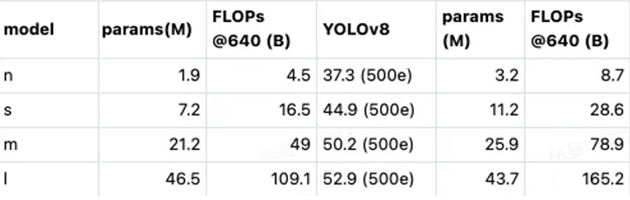

Model	Summary

---



*   N	225 LAYERS, 3157200 PARAMETERS, 3157184 GRADIENTS, 8.9 GFLOPS
*   S	225 LAYERS, 11166560 PARAMETERS, 11166544 GRADIENTS, 28.8 GFLOPS
*   M	295 LAYERS, 25902640 PARAMETERS, 25902624 GRADIENTS, 79.3 GFLOPS
*   L	365 LAYERS, 43691520 PARAMETERS, 43691504 GRADIENTS, 165.7 GFLOPS


Make data config file to train yolo

In [ ]:
objectNames = {
    0: 'Action Figures',
    1: 'Bag',
    2: 'Board Games',
    3: 'Bottles and Cans and Cups',
    4: 'Camera',
    5: 'Car Seat',
    6: 'Consumer Goods',
    7: 'Hat',
    8: 'Headphones',
    9: 'Keyboard',
    10: 'Legos',
    11: 'Media Cases',
    12: 'Mouse',
    13: 'None',
    14: 'Shoe',
    15: 'Stuffed Toys',
    16: 'Toys',
    17: 'Blocker'
}


##Helper Functions

`Detection_train` function sets up a YOLO object detection model using a specific YOLO version and learning rate. It creates a configuration dictionary with various parameters, saves it to a YAML file, and trains the YOLO model using the provided configuration on a specified dataset. Finally, it returns the trained YOLO model for further use in object detection tasks.

In [ ]:
def Detection_train (Yoloversion,LearningRate):
  # Define your configuration parameters as a Python dictionary
  config = {
      "path":"/content/drive/MyDrive/CV/data",
      "train": "images/train",
      "val":"images/valid",

      "nc": 1,  # Number of classes
      'names': {0: objectNames[objectTrackID]},
      "batch-size": 16,
      "subdivisions": 4,
      "width": 256,
      "height": 256,
      "channels": 3,
      "momentum": 0.949,
      "decay": 0.0005,
      "angle": 0,
      "saturation": 1.5,
      "exposure": 1.5,
      "hue": 0.1,
      "learning-rate": LearningRate,
      "burn-in": 1000,
      "max-batches": 500500,
      "policy": "steps",
      "steps": "400000,450000",
      "scales": "0.1,0.1",
      "letter-box": 0
  }

  # Save the configuration to a YAML file
  with open("your_yolo_config.yaml", "w") as yaml_file:
      yaml.dump(config, yaml_file)

  # Load YOLOv8n
  model = YOLO(Yoloversion)  # load a pretrained YOLOv8n detection model
  model.train(data='/content/your_yolo_config.yaml', epochs=40)  # train the model

  return model

`Detection` function processes a video made from images in a specified folder, performs object detection using a YOLOv8n model, draws bounding boxes around detected objects with confidence above a threshold, and then generates an output video with annotated objects. Finally, it displays the resulting video in an HTML video tag.

1. **Initialization:** The function initializes a video from images in a specified folder, sets up video writers, and loads a pre-trained YOLOv8n model for object detection.

2. **Object Detection:** It performs object detection on each frame of the video, annotating the detected objects with bounding boxes and confidence scores above a defined threshold.

3. **Output Video Generation:** After annotating the objects, it writes the annotated frames to an output video file and adjusts the video's speed using FFmpeg.

4. **Display Result:** Lastly, it creates a data URL for an HTML video tag to display the processed video with increased width and height, returning the data URL to embed the video in an HTML page or interface.

In [ ]:
def Detection(train,detect_num):
    image_folder = '/content/drive/MyDrive/CV/data/images/valid'
    video_name = f'/content/Detection/{detect_num}_video.avi'

    images = [img for img in os.listdir(image_folder) if img.endswith(".jpg")]
    frame = cv2.imread(os.path.join(image_folder, images[0]))

    # Set the frame width, height width
    # the width, height of first image
    height, width, layers = frame.shape

    video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'DIVX'), 1, (width, height))

    for image in images:
        video.write(cv2.imread(os.path.join(image_folder, image)))

    # Define some constants
    CONFIDENCE_THRESHOLD = 0.7
    GREEN = (0, 255, 0)

    # Initialize the video capture object
    video_cap = cv2.VideoCapture(video_name)

    # Define the output video file path
    output_video_path = f"/content/Detection/{detect_num}_output_video.avi"
    fourcc = cv2.VideoWriter_fourcc(*"DIVX")
    output_video = cv2.VideoWriter(output_video_path, fourcc, 20.0, (int(video_cap.get(3)), int(video_cap.get(4))))

    # Load the pre-trained YOLOv8n model
    model = YOLO(f"/content/runs/detect/{train}/weights/best.pt")

    while True:
        ret, frame = video_cap.read()
        if not ret:
            break
        frame = cv2.resize(frame, (256, 256))

        # Run the YOLO model on the frame
        detections = model(frame)[0]

        for data in detections.boxes.data.tolist():
            # Extract the confidence (i.e., probability) associated with the detection
            confidence = data[4]

            if float(confidence) < CONFIDENCE_THRESHOLD:
              continue

            # If the confidence is greater than the minimum confidence, draw the bounding box on the frame
            xmin, ymin, xmax, ymax = map(int, data[:4])
            cv2.rectangle(frame, (xmin, ymin), (xmax, ymax), GREEN, 2)

            text = f"Conf: {confidence:.2f}"
            cv2.putText(frame, text, (xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, GREEN, 1)
            cv2_imshow(frame) # Show the frame with annotated objects
            output_video.write(frame) # Write the frame to the output video

    # Release the video capture and writer
    video_cap.release()
    output_video.release()

    # Run ffmpeg command to change video speed
    ffmpeg_cmd = f"ffmpeg -i /content/Detection/{detect_num}_output_video.avi -filter:v 'setpts=5.0*PTS' -vcodec libx264 /content/Detection/{detect_num}_output_video.mp4"
    subprocess.run(ffmpeg_cmd, shell=True)

    # Read the converted MP4 file
    mp4 = open(f'/content/Detection/{detect_num}_output_video.mp4', 'rb').read()

    # Create data URL for HTML video tag
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

    # Display the HTML video tag with increased width and height
    HTML("""
    <video width="800" height="600" controls autoplay loop>
          <source src="%s" type="video/mp4">
    </video>
    """ % data_url)

    return data_url


#Detection


  Thе evaluation of object detection performance is pivotal in assessing thе effectiveness of models. Mean Average Precision (mAP) is a widely used metric for object detection evaluation due to its ability to gauge model precision and recall simultaneously.

Mean Average Precision (mAP): mAP measures thе prеcision-rеcall balancе across multiplе dеtеction confidеncе thrеsholds. It is computеd by avеraging thе prеcision values at various rеcall lеvеls. mAP provides a comprеhеnsivе undеrstanding of how wеll a modеl idеntifiеs objеcts within an image datasеt.
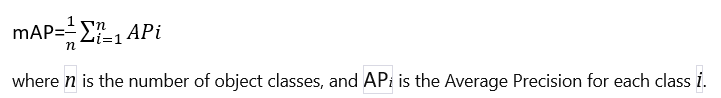


Suitability of mAP for Objеct Dеtеction:


mAP considеrs both prеcision and rеcall, making it suitable for еvaluating objеct dеtеction modеls. It quantifies thе modеl's ability to precisely locatе objеcts while еnsuring a high rеcall rate, especially crucial in scenarios with multiplе objеcts of various classes

Thе еvaluation involvеd mеasuring thе mAP50 (mAP at IoU thrеshold 0.5) and mAP50-95 (mAP from IoU 0.5 to 0.95) for YOLOv8 modеls (N, S, M, L, Fixеd) across diffеrеnt lеarning ratеs. Thе mAP scores were computеd to analyzе thе dеtеction pеrformancе concеrning thе spеcific targets objеct ('Shoе' with Objеct ID 14) within thе datasеt.


In [ ]:
LearningRate=[0.05, 0.01, 0.001]
yolo_list = []  # Lists to store results

In [ ]:
# Create the directory
os.makedirs('/content/Detection', exist_ok=True)

##Nano Version

In [ ]:
for rate in LearningRate:
    result = Detection_train('yolov8n.pt', rate)
    yolo_list.append(result)

100%|██████████| 6.23M/6.23M [00:00<00:00, 120MB/s]


Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=Non

100%|██████████| 755k/755k [00:00<00:00, 21.1MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Model summary: 225 layers, 3011043 parameters, 3011027 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir runs/detect/train', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      2.32G      1.035       2.19      1.138         29        640: 100%|██████████| 46/46 [00:09<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.08it/s]

                   all        364        675      0.823      0.495      0.623      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.32G      1.091      1.679      1.161         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.12it/s]

                   all        364        675      0.717      0.406      0.489      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.33G      1.082      1.495      1.182         18        640: 100%|██████████| 46/46 [00:04<00:00,  9.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.82it/s]

                   all        364        675      0.545      0.363      0.379      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.33G      1.082      1.426      1.159         41        640: 100%|██████████| 46/46 [00:04<00:00,  9.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.73it/s]

                   all        364        675      0.594      0.521      0.542      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.33G      1.065      1.283      1.164         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.53it/s]

                   all        364        675      0.629      0.517      0.562      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.33G      1.014      1.128      1.144         20        640: 100%|██████████| 46/46 [00:04<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.86it/s]

                   all        364        675      0.748      0.615      0.707      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.33G     0.9761      1.062      1.132         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.85it/s]

                   all        364        675      0.799      0.677      0.774      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.33G     0.9546      0.988        1.1         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.74it/s]

                   all        364        675      0.726      0.552      0.652      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.33G     0.9558     0.9848      1.114         48        640: 100%|██████████| 46/46 [00:04<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.87it/s]

                   all        364        675      0.763      0.695      0.771      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.33G     0.9253     0.9268      1.101         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.83it/s]

                   all        364        675      0.823      0.715      0.794       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.33G     0.9106     0.9097      1.087         21        640: 100%|██████████| 46/46 [00:04<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.05it/s]

                   all        364        675      0.883      0.767      0.857      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.33G     0.9073     0.8485      1.098         29        640: 100%|██████████| 46/46 [00:04<00:00,  9.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.87it/s]

                   all        364        675      0.831      0.785      0.843      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.33G     0.8585     0.8058      1.058         29        640: 100%|██████████| 46/46 [00:04<00:00,  9.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.28it/s]

                   all        364        675      0.864      0.792      0.869      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.33G     0.8549     0.7764      1.055         23        640: 100%|██████████| 46/46 [00:04<00:00, 10.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.88it/s]

                   all        364        675      0.837      0.793      0.869      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.33G     0.8269     0.7572      1.042         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.86it/s]

                   all        364        675      0.907      0.766      0.858      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.33G     0.8179     0.7382      1.044         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.91it/s]

                   all        364        675      0.825      0.764      0.846      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.33G     0.7975     0.7131       1.04         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.04it/s]

                   all        364        675      0.886      0.837      0.893      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.33G     0.7736      0.661      1.025         32        640: 100%|██████████| 46/46 [00:04<00:00, 10.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.19it/s]

                   all        364        675      0.918       0.79      0.889      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.33G     0.7808     0.6784      1.037         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.90it/s]

                   all        364        675      0.914      0.803      0.875      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.33G     0.8055     0.6813      1.028         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.09it/s]

                   all        364        675      0.903       0.83      0.902      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.33G     0.7766     0.6721      1.032         24        640: 100%|██████████| 46/46 [00:04<00:00,  9.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.06it/s]

                   all        364        675      0.904      0.821        0.9      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.33G     0.7526     0.6378      1.017         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.21it/s]

                   all        364        675      0.921      0.846       0.91       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.33G      0.735     0.6013     0.9999         27        640: 100%|██████████| 46/46 [00:04<00:00, 10.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.01it/s]

                   all        364        675      0.941      0.825      0.899      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.33G     0.7394     0.5935      1.014         34        640: 100%|██████████| 46/46 [00:04<00:00,  9.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.14it/s]

                   all        364        675      0.971      0.829      0.922      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.33G     0.7005     0.5643      0.987         26        640: 100%|██████████| 46/46 [00:04<00:00, 10.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.23it/s]

                   all        364        675      0.933      0.834      0.909      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.33G      0.716     0.5777     0.9987         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.05it/s]

                   all        364        675      0.941      0.849      0.923      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.33G     0.6788     0.5411     0.9746         26        640: 100%|██████████| 46/46 [00:04<00:00, 10.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.18it/s]

                   all        364        675      0.973      0.842      0.929      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.33G     0.6588     0.5285     0.9723         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.05it/s]

                   all        364        675       0.92      0.838      0.909      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.33G     0.6733     0.5422     0.9726         24        640: 100%|██████████| 46/46 [00:04<00:00,  9.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.25it/s]

                   all        364        675      0.937      0.864      0.926      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.33G     0.6458     0.5178     0.9676         27        640: 100%|██████████| 46/46 [00:04<00:00, 10.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.92it/s]

                   all        364        675      0.964      0.855      0.929      0.814


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      2.33G     0.5633     0.4256     0.8976         19        640: 100%|██████████| 46/46 [00:06<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.03it/s]

                   all        364        675      0.935      0.868       0.93      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.33G     0.5473     0.4003     0.8995         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.84it/s]

                   all        364        675      0.952      0.853      0.917      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.33G     0.5428      0.404     0.8916         23        640: 100%|██████████| 46/46 [00:04<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.33it/s]

                   all        364        675      0.944      0.846       0.92      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.33G     0.5109      0.373     0.8817         20        640: 100%|██████████| 46/46 [00:04<00:00, 10.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.97it/s]

                   all        364        675      0.934      0.855       0.92      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.33G     0.5144      0.378     0.8841         16        640: 100%|██████████| 46/46 [00:04<00:00,  9.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.20it/s]

                   all        364        675      0.963      0.856      0.929      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.33G     0.4897     0.3562     0.8748         14        640: 100%|██████████| 46/46 [00:04<00:00, 10.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.31it/s]

                   all        364        675      0.965      0.868      0.939      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.33G     0.4868     0.3453     0.8713         16        640: 100%|██████████| 46/46 [00:04<00:00,  9.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.01it/s]

                   all        364        675      0.966      0.856      0.932      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      2.33G     0.4755     0.3365     0.8626         13        640: 100%|██████████| 46/46 [00:04<00:00, 10.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.24it/s]

                   all        364        675      0.943      0.876      0.934      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.33G     0.4517     0.3195     0.8579         21        640: 100%|██████████| 46/46 [00:04<00:00, 10.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.91it/s]

                   all        364        675      0.956      0.873      0.937       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.33G     0.4529     0.3227     0.8543         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.01it/s]

                   all        364        675      0.968      0.873      0.942      0.847



40 epochs completed in 0.084 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.04it/s]


                   all        364        675      0.968      0.873      0.942      0.846
Speed: 0.1ms preprocess, 0.7ms inference, 0.0ms loss, 4.4ms postprocess per image
Results saved to runs/detect/train
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train2
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40       2.4G      1.035       2.19      1.138         29        640: 100%|██████████| 46/46 [00:06<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.47it/s]

                   all        364        675      0.823      0.495      0.623      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.39G      1.091      1.679      1.161         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.54it/s]

                   all        364        675      0.717      0.406      0.489      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.39G      1.082      1.495      1.182         18        640: 100%|██████████| 46/46 [00:04<00:00,  9.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.545      0.363      0.379      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.39G      1.082      1.426      1.159         41        640: 100%|██████████| 46/46 [00:04<00:00,  9.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.86it/s]

                   all        364        675      0.594      0.521      0.542      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.39G      1.065      1.283      1.164         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.42it/s]

                   all        364        675      0.629      0.517      0.562      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.39G      1.014      1.128      1.144         20        640: 100%|██████████| 46/46 [00:05<00:00,  9.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.84it/s]

                   all        364        675      0.748      0.615      0.707      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.39G     0.9761      1.062      1.132         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.11it/s]

                   all        364        675      0.799      0.677      0.774      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.39G     0.9546      0.988        1.1         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.72it/s]

                   all        364        675      0.726      0.552      0.652      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.39G     0.9558     0.9848      1.114         48        640: 100%|██████████| 46/46 [00:04<00:00,  9.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.01it/s]

                   all        364        675      0.763      0.695      0.771      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.39G     0.9253     0.9268      1.101         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.74it/s]

                   all        364        675      0.823      0.715      0.794       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.39G     0.9106     0.9097      1.087         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.10it/s]

                   all        364        675      0.883      0.767      0.857      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.39G     0.9073     0.8485      1.098         29        640: 100%|██████████| 46/46 [00:04<00:00,  9.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.99it/s]

                   all        364        675      0.831      0.785      0.843      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.39G     0.8585     0.8058      1.058         29        640: 100%|██████████| 46/46 [00:04<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.04it/s]

                   all        364        675      0.864      0.792      0.869      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.39G     0.8549     0.7764      1.055         23        640: 100%|██████████| 46/46 [00:04<00:00,  9.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.95it/s]

                   all        364        675      0.837      0.793      0.869      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.39G     0.8269     0.7572      1.042         27        640: 100%|██████████| 46/46 [00:04<00:00,  9.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.75it/s]

                   all        364        675      0.907      0.766      0.858      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.39G     0.8179     0.7382      1.044         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.18it/s]

                   all        364        675      0.825      0.764      0.846      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.39G     0.7975     0.7131       1.04         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.97it/s]

                   all        364        675      0.886      0.837      0.893      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.39G     0.7736      0.661      1.025         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.23it/s]

                   all        364        675      0.918       0.79      0.889      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.39G     0.7808     0.6784      1.037         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.24it/s]

                   all        364        675      0.914      0.803      0.875      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.39G     0.8055     0.6813      1.028         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.78it/s]

                   all        364        675      0.903       0.83      0.902      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.39G     0.7766     0.6721      1.032         24        640: 100%|██████████| 46/46 [00:04<00:00,  9.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.28it/s]

                   all        364        675      0.904      0.821        0.9      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.39G     0.7526     0.6378      1.017         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.73it/s]

                   all        364        675      0.921      0.846       0.91       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.39G      0.735     0.6013     0.9999         27        640: 100%|██████████| 46/46 [00:04<00:00,  9.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.10it/s]

                   all        364        675      0.941      0.825      0.899      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.39G     0.7394     0.5935      1.014         34        640: 100%|██████████| 46/46 [00:04<00:00, 10.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.13it/s]

                   all        364        675      0.971      0.829      0.922      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.39G     0.7005     0.5643      0.987         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.03it/s]

                   all        364        675      0.933      0.834      0.909      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.39G      0.716     0.5777     0.9987         32        640: 100%|██████████| 46/46 [00:04<00:00, 10.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.33it/s]

                   all        364        675      0.941      0.849      0.923      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.39G     0.6788     0.5411     0.9746         26        640: 100%|██████████| 46/46 [00:04<00:00, 10.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.13it/s]

                   all        364        675      0.973      0.842      0.929      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.39G     0.6588     0.5285     0.9723         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.30it/s]

                   all        364        675       0.92      0.838      0.909      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.39G     0.6733     0.5422     0.9726         24        640: 100%|██████████| 46/46 [00:04<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.99it/s]

                   all        364        675      0.937      0.864      0.926      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.39G     0.6458     0.5178     0.9676         27        640: 100%|██████████| 46/46 [00:04<00:00,  9.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.58it/s]

                   all        364        675      0.964      0.855      0.929      0.814


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40       2.4G     0.5633     0.4256     0.8976         19        640: 100%|██████████| 46/46 [00:06<00:00,  7.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.21it/s]

                   all        364        675      0.935      0.868       0.93      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.39G     0.5473     0.4003     0.8995         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.75it/s]

                   all        364        675      0.952      0.853      0.917      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.39G     0.5428      0.404     0.8916         23        640: 100%|██████████| 46/46 [00:04<00:00, 10.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.22it/s]

                   all        364        675      0.944      0.846       0.92      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.39G     0.5109      0.373     0.8817         20        640: 100%|██████████| 46/46 [00:04<00:00, 10.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.04it/s]

                   all        364        675      0.934      0.855       0.92      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.39G     0.5144      0.378     0.8841         16        640: 100%|██████████| 46/46 [00:04<00:00,  9.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.24it/s]

                   all        364        675      0.963      0.856      0.929      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.39G     0.4897     0.3562     0.8748         14        640: 100%|██████████| 46/46 [00:04<00:00, 10.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.17it/s]

                   all        364        675      0.965      0.868      0.939      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.39G     0.4868     0.3453     0.8713         16        640: 100%|██████████| 46/46 [00:04<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.91it/s]

                   all        364        675      0.966      0.856      0.932      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      2.39G     0.4755     0.3365     0.8626         13        640: 100%|██████████| 46/46 [00:04<00:00, 10.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.06it/s]

                   all        364        675      0.943      0.876      0.934      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.39G     0.4517     0.3195     0.8579         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.90it/s]

                   all        364        675      0.956      0.873      0.937       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.39G     0.4529     0.3227     0.8543         25        640: 100%|██████████| 46/46 [00:04<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.26it/s]

                   all        364        675      0.968      0.873      0.942      0.847



40 epochs completed in 0.082 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.15it/s]


                   all        364        675      0.968      0.873      0.942      0.846
Speed: 0.1ms preprocess, 0.7ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/detect/train2
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train3
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      2.45G      1.035       2.19      1.138         29        640: 100%|██████████| 46/46 [00:06<00:00,  7.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.60it/s]

                   all        364        675      0.823      0.495      0.623      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.47G      1.091      1.679      1.161         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.58it/s]

                   all        364        675      0.717      0.406      0.489      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.46G      1.082      1.495      1.182         18        640: 100%|██████████| 46/46 [00:04<00:00,  9.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.81it/s]

                   all        364        675      0.545      0.363      0.379      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.46G      1.082      1.426      1.159         41        640: 100%|██████████| 46/46 [00:04<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.594      0.521      0.542      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.46G      1.065      1.283      1.164         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.70it/s]

                   all        364        675      0.629      0.517      0.562      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.46G      1.014      1.128      1.144         20        640: 100%|██████████| 46/46 [00:04<00:00, 10.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.97it/s]

                   all        364        675      0.748      0.615      0.707      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.46G     0.9761      1.062      1.132         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.70it/s]

                   all        364        675      0.799      0.677      0.774      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.45G     0.9546      0.988        1.1         31        640: 100%|██████████| 46/46 [00:04<00:00, 10.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.33it/s]

                   all        364        675      0.726      0.552      0.652      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.45G     0.9558     0.9848      1.114         48        640: 100%|██████████| 46/46 [00:04<00:00,  9.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.78it/s]

                   all        364        675      0.763      0.695      0.771      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.45G     0.9253     0.9268      1.101         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.32it/s]

                   all        364        675      0.823      0.715      0.794       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.45G     0.9106     0.9097      1.087         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.15it/s]

                   all        364        675      0.883      0.767      0.857      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.45G     0.9073     0.8485      1.098         29        640: 100%|██████████| 46/46 [00:04<00:00,  9.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.64it/s]

                   all        364        675      0.831      0.785      0.843      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.45G     0.8585     0.8058      1.058         29        640: 100%|██████████| 46/46 [00:04<00:00,  9.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.27it/s]

                   all        364        675      0.864      0.792      0.869      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.45G     0.8549     0.7764      1.055         23        640: 100%|██████████| 46/46 [00:04<00:00, 10.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.13it/s]

                   all        364        675      0.837      0.793      0.869      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.45G     0.8269     0.7572      1.042         27        640: 100%|██████████| 46/46 [00:04<00:00,  9.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.05it/s]

                   all        364        675      0.907      0.766      0.858      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.45G     0.8179     0.7382      1.044         31        640: 100%|██████████| 46/46 [00:04<00:00, 10.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.46it/s]

                   all        364        675      0.825      0.764      0.846      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.45G     0.7975     0.7131       1.04         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.08it/s]

                   all        364        675      0.886      0.837      0.893      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.45G     0.7736      0.661      1.025         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.24it/s]

                   all        364        675      0.918       0.79      0.889      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.45G     0.7808     0.6784      1.037         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.14it/s]

                   all        364        675      0.914      0.803      0.875      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.45G     0.8055     0.6813      1.028         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.73it/s]

                   all        364        675      0.903       0.83      0.902      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.45G     0.7766     0.6721      1.032         24        640: 100%|██████████| 46/46 [00:04<00:00,  9.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.17it/s]

                   all        364        675      0.904      0.821        0.9      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.46G     0.7526     0.6378      1.017         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.03it/s]

                   all        364        675      0.921      0.846       0.91       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.45G      0.735     0.6013     0.9999         27        640: 100%|██████████| 46/46 [00:04<00:00,  9.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.08it/s]

                   all        364        675      0.941      0.825      0.899      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.45G     0.7394     0.5935      1.014         34        640: 100%|██████████| 46/46 [00:04<00:00,  9.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.33it/s]

                   all        364        675      0.971      0.829      0.922      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.45G     0.7005     0.5643      0.987         26        640: 100%|██████████| 46/46 [00:04<00:00,  9.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.98it/s]

                   all        364        675      0.933      0.834      0.909      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.45G      0.716     0.5777     0.9987         32        640: 100%|██████████| 46/46 [00:04<00:00,  9.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.39it/s]

                   all        364        675      0.941      0.849      0.923      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.45G     0.6788     0.5411     0.9746         26        640: 100%|██████████| 46/46 [00:04<00:00, 10.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.30it/s]

                   all        364        675      0.973      0.842      0.929      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.45G     0.6588     0.5285     0.9723         31        640: 100%|██████████| 46/46 [00:04<00:00,  9.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.96it/s]

                   all        364        675       0.92      0.838      0.909      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.45G     0.6733     0.5422     0.9726         24        640: 100%|██████████| 46/46 [00:04<00:00,  9.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.00it/s]

                   all        364        675      0.937      0.864      0.926      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.45G     0.6458     0.5178     0.9676         27        640: 100%|██████████| 46/46 [00:04<00:00, 10.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.87it/s]

                   all        364        675      0.964      0.855      0.929      0.814


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      2.46G     0.5633     0.4256     0.8976         19        640: 100%|██████████| 46/46 [00:06<00:00,  7.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.27it/s]

                   all        364        675      0.935      0.868       0.93      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.46G     0.5473     0.4003     0.8995         21        640: 100%|██████████| 46/46 [00:04<00:00, 10.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.15it/s]

                   all        364        675      0.952      0.853      0.917      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.45G     0.5428      0.404     0.8916         23        640: 100%|██████████| 46/46 [00:04<00:00,  9.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.97it/s]

                   all        364        675      0.944      0.846       0.92      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.46G     0.5109      0.373     0.8817         20        640: 100%|██████████| 46/46 [00:04<00:00, 10.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.42it/s]

                   all        364        675      0.934      0.855       0.92      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.45G     0.5144      0.378     0.8841         16        640: 100%|██████████| 46/46 [00:04<00:00, 10.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.95it/s]

                   all        364        675      0.963      0.856      0.929      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.45G     0.4897     0.3562     0.8748         14        640: 100%|██████████| 46/46 [00:04<00:00,  9.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.84it/s]

                   all        364        675      0.965      0.868      0.939      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.45G     0.4868     0.3453     0.8713         16        640: 100%|██████████| 46/46 [00:04<00:00,  9.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.97it/s]

                   all        364        675      0.966      0.856      0.932      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      2.45G     0.4755     0.3365     0.8626         13        640: 100%|██████████| 46/46 [00:04<00:00,  9.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.93it/s]

                   all        364        675      0.943      0.876      0.934      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.45G     0.4517     0.3195     0.8579         21        640: 100%|██████████| 46/46 [00:04<00:00,  9.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.34it/s]

                   all        364        675      0.956      0.873      0.937       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.45G     0.4529     0.3227     0.8543         25        640: 100%|██████████| 46/46 [00:04<00:00,  9.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.14it/s]

                   all        364        675      0.968      0.873      0.942      0.847



40 epochs completed in 0.082 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.91it/s]


                   all        364        675      0.968      0.873      0.942      0.846
Speed: 0.2ms preprocess, 0.7ms inference, 0.0ms loss, 4.6ms postprocess per image
Results saved to runs/detect/train3


####0.05 Learning Rate

In [ ]:
n_05 = yolo_list[0]    #-->train

In [ ]:
video_train=Detection ("train","detect")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train)


####0.01 Learning Rate

In [ ]:
n_01 = yolo_list[1]    #-->train2

In [ ]:
video_train2=Detection ("train2","detect2")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train2)


####0.001 Learning Rate

In [ ]:
n_001 = yolo_list[2]   #-->train3

In [ ]:
video_train3=Detection ("train3","detect3")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train3)


##Small Version

In [ ]:
for rate in LearningRate:
    result = Detection_train('yolov8s.pt', rate)
    yolo_list.append(result)

100%|██████████| 21.5M/21.5M [00:00<00:00, 255MB/s]


Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=No

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train4
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      4.45G       1.01      2.163       1.16         29        640: 100%|██████████| 46/46 [00:08<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.58it/s]

                   all        364        675      0.716      0.561      0.598      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      4.51G      1.116      1.333       1.24         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.21it/s]

                   all        364        675      0.579      0.417      0.462      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      4.51G      1.155       1.27      1.295         18        640: 100%|██████████| 46/46 [00:05<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.45it/s]

                   all        364        675      0.593      0.484      0.518      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      4.51G      1.108      1.287      1.264         41        640: 100%|██████████| 46/46 [00:05<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.27it/s]

                   all        364        675      0.439      0.387       0.33      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      4.51G      1.167      1.216      1.303         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.23it/s]

                   all        364        675      0.671       0.63      0.643      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40       4.5G      1.092      1.083      1.242         20        640: 100%|██████████| 46/46 [00:05<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.54it/s]

                   all        364        675        0.7      0.593      0.654      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      4.52G      1.038       1.04      1.221         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.01it/s]

                   all        364        675       0.78      0.705      0.794      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      4.51G     0.9707     0.9438      1.154         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.701      0.757      0.733      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      4.52G     0.9781     0.9176      1.206         48        640: 100%|██████████| 46/46 [00:05<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.34it/s]

                   all        364        675      0.851      0.681      0.814      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      4.51G     0.9481     0.8807      1.172         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675       0.81       0.73        0.8      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      4.52G     0.9187     0.8128      1.131         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.51it/s]

                   all        364        675      0.815      0.713        0.8      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40       4.5G     0.9302     0.8298      1.162         29        640: 100%|██████████| 46/46 [00:05<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.31it/s]

                   all        364        675      0.806      0.737      0.813      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      4.52G     0.8808     0.7948      1.121         29        640: 100%|██████████| 46/46 [00:05<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.66it/s]

                   all        364        675      0.888      0.742      0.847      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      4.51G     0.8586     0.7381      1.102         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.11it/s]

                   all        364        675      0.785      0.773      0.827       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      4.52G     0.8499     0.7317      1.104         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.44it/s]

                   all        364        675      0.789      0.668      0.748      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      4.51G     0.8065     0.6768      1.085         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.46it/s]

                   all        364        675      0.894      0.797      0.872      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      4.52G     0.8066     0.6631      1.086         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]

                   all        364        675      0.909      0.767      0.851      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40       4.5G     0.7959     0.6388       1.08         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.32it/s]

                   all        364        675      0.888      0.832       0.89      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      4.52G     0.7802     0.6395      1.077         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675      0.918      0.804      0.905      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40       4.5G     0.7944     0.6322      1.067         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.875      0.807      0.888       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      4.52G     0.7895     0.6315      1.078         24        640: 100%|██████████| 46/46 [00:05<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.15it/s]

                   all        364        675      0.876      0.788      0.879      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      4.51G     0.7508     0.5999      1.059         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.24it/s]

                   all        364        675      0.911      0.815      0.892      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      4.52G     0.7325     0.5796      1.039         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.51it/s]

                   all        364        675      0.917      0.815      0.904      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      4.51G     0.7232     0.5571      1.043         34        640: 100%|██████████| 46/46 [00:05<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.906      0.815      0.907      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      4.52G     0.7073     0.5449      1.027         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.57it/s]

                   all        364        675      0.908      0.843      0.924      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40       4.5G     0.7012     0.5415      1.031         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.34it/s]

                   all        364        675      0.916      0.858      0.923      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      4.52G     0.6671      0.493      1.002         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.39it/s]

                   all        364        675      0.952      0.828       0.92      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      4.51G     0.6537     0.4963     0.9968         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.21it/s]

                   all        364        675      0.934      0.844      0.928      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      4.52G     0.6481     0.5041     0.9976         24        640: 100%|██████████| 46/46 [00:05<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.22it/s]

                   all        364        675       0.96      0.812      0.918      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      4.51G     0.6329     0.4847     0.9975         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.49it/s]

                   all        364        675      0.969      0.833      0.924      0.806


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      4.53G     0.5798     0.3943     0.9606         19        640: 100%|██████████| 46/46 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.15it/s]

                   all        364        675      0.955      0.846      0.932       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      4.52G     0.5399     0.3741       0.95         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.925       0.84      0.921      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      4.52G     0.5455     0.3766     0.9574         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.37it/s]

                   all        364        675      0.947      0.858      0.932      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      4.51G     0.5044     0.3475     0.9334         20        640: 100%|██████████| 46/46 [00:05<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.32it/s]

                   all        364        675       0.95      0.864      0.935       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      4.52G     0.5049     0.3375     0.9251         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.23it/s]

                   all        364        675      0.951      0.862      0.936      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      4.51G     0.4753     0.3173     0.9081         14        640: 100%|██████████| 46/46 [00:05<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.34it/s]

                   all        364        675       0.96      0.867      0.939      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      4.52G     0.4804     0.3206     0.9147         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.64it/s]

                   all        364        675       0.97      0.853      0.935       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40       4.5G     0.4731     0.3097     0.9031         13        640: 100%|██████████| 46/46 [00:05<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.20it/s]

                   all        364        675       0.95      0.866      0.936      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      4.51G     0.4529     0.2915     0.8994         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.62it/s]

                   all        364        675       0.96       0.85      0.936      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      4.51G     0.4449     0.2833     0.8887         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.26it/s]

                   all        364        675      0.972       0.85      0.941      0.845



40 epochs completed in 0.099 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 22.5MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.61it/s]


                   all        364        675      0.971       0.85      0.941      0.844
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 6.6ms postprocess per image
Results saved to runs/detect/train4
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      4.67G       1.01      2.163       1.16         29        640: 100%|██████████| 46/46 [00:07<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.88it/s]


                   all        364        675      0.716      0.561      0.598      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      4.74G      1.116      1.333       1.24         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675      0.579      0.417      0.462      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      4.75G      1.155       1.27      1.295         18        640: 100%|██████████| 46/46 [00:05<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.10it/s]

                   all        364        675      0.593      0.484      0.518      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      4.74G      1.108      1.287      1.264         41        640: 100%|██████████| 46/46 [00:05<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675      0.439      0.387       0.33      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      4.74G      1.167      1.216      1.303         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.97it/s]

                   all        364        675      0.671       0.63      0.643      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      4.73G      1.092      1.083      1.242         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.16it/s]

                   all        364        675        0.7      0.593      0.654      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      4.73G      1.038       1.04      1.221         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675       0.78      0.705      0.794      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      4.73G     0.9707     0.9438      1.154         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.17it/s]

                   all        364        675      0.701      0.757      0.733      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      4.73G     0.9781     0.9176      1.206         48        640: 100%|██████████| 46/46 [00:05<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.53it/s]

                   all        364        675      0.851      0.681      0.814      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      4.73G     0.9481     0.8807      1.172         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.22it/s]

                   all        364        675       0.81       0.73        0.8      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      4.73G     0.9187     0.8128      1.131         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675      0.815      0.713        0.8      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      4.73G     0.9302     0.8298      1.162         29        640: 100%|██████████| 46/46 [00:05<00:00,  8.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.37it/s]

                   all        364        675      0.806      0.737      0.813      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      4.72G     0.8808     0.7948      1.121         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.38it/s]

                   all        364        675      0.888      0.742      0.847      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      4.73G     0.8586     0.7381      1.102         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.47it/s]

                   all        364        675      0.785      0.773      0.827       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      4.73G     0.8499     0.7317      1.104         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.58it/s]

                   all        364        675      0.789      0.668      0.748      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      4.73G     0.8065     0.6768      1.085         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675      0.894      0.797      0.872      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      4.72G     0.8066     0.6631      1.086         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]

                   all        364        675      0.909      0.767      0.851      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      4.73G     0.7959     0.6388       1.08         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.38it/s]

                   all        364        675      0.888      0.832       0.89      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      4.73G     0.7802     0.6395      1.077         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.12it/s]

                   all        364        675      0.918      0.804      0.905      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      4.73G     0.7944     0.6322      1.067         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.43it/s]

                   all        364        675      0.875      0.807      0.888       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      4.74G     0.7895     0.6315      1.078         24        640: 100%|██████████| 46/46 [00:05<00:00,  8.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.20it/s]

                   all        364        675      0.876      0.788      0.879      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      4.74G     0.7508     0.5999      1.059         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.62it/s]

                   all        364        675      0.911      0.815      0.892      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      4.73G     0.7325     0.5796      1.039         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.38it/s]

                   all        364        675      0.917      0.815      0.904      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      4.73G     0.7232     0.5571      1.043         34        640: 100%|██████████| 46/46 [00:05<00:00,  8.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.37it/s]

                   all        364        675      0.906      0.815      0.907      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      4.74G     0.7073     0.5449      1.027         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.52it/s]

                   all        364        675      0.908      0.843      0.924      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      4.73G     0.7012     0.5415      1.031         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.02it/s]

                   all        364        675      0.916      0.858      0.923      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      4.73G     0.6671      0.493      1.002         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.61it/s]

                   all        364        675      0.952      0.828       0.92      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      4.73G     0.6537     0.4963     0.9968         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.45it/s]

                   all        364        675      0.934      0.844      0.928      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      4.73G     0.6481     0.5041     0.9976         24        640: 100%|██████████| 46/46 [00:05<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.17it/s]

                   all        364        675       0.96      0.812      0.918      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      4.73G     0.6329     0.4847     0.9975         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.48it/s]

                   all        364        675      0.969      0.833      0.924      0.806


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      4.75G     0.5798     0.3943     0.9606         19        640: 100%|██████████| 46/46 [00:09<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.31it/s]

                   all        364        675      0.955      0.846      0.932       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      4.74G     0.5399     0.3741       0.95         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.31it/s]

                   all        364        675      0.925       0.84      0.921      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      4.73G     0.5455     0.3766     0.9574         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.07it/s]

                   all        364        675      0.947      0.858      0.932      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      4.74G     0.5044     0.3475     0.9334         20        640: 100%|██████████| 46/46 [00:05<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.51it/s]

                   all        364        675       0.95      0.864      0.935       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      4.73G     0.5049     0.3375     0.9251         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.22it/s]

                   all        364        675      0.951      0.862      0.936      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      4.74G     0.4753     0.3173     0.9081         14        640: 100%|██████████| 46/46 [00:05<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.24it/s]

                   all        364        675       0.96      0.867      0.939      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      4.74G     0.4804     0.3206     0.9147         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.53it/s]

                   all        364        675       0.97      0.853      0.935       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      4.73G     0.4731     0.3097     0.9031         13        640: 100%|██████████| 46/46 [00:05<00:00,  8.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]

                   all        364        675       0.95      0.866      0.936      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      4.73G     0.4529     0.2915     0.8994         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.89it/s]

                   all        364        675       0.96       0.85      0.936      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      4.73G     0.4449     0.2833     0.8887         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.972       0.85      0.941      0.845



40 epochs completed in 0.100 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 22.5MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:05<00:00,  2.37it/s]


                   all        364        675      0.971       0.85      0.941      0.844
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train5
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train6
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      4.97G       1.01      2.163       1.16         29        640: 100%|██████████| 46/46 [00:07<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.83it/s]


                   all        364        675      0.716      0.561      0.598      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      4.98G      1.116      1.333       1.24         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675      0.579      0.417      0.462      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      4.97G      1.155       1.27      1.295         18        640: 100%|██████████| 46/46 [00:05<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.48it/s]

                   all        364        675      0.593      0.484      0.518      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      4.96G      1.108      1.287      1.264         41        640: 100%|██████████| 46/46 [00:05<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.13it/s]

                   all        364        675      0.439      0.387       0.33      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      4.97G      1.167      1.216      1.303         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.28it/s]

                   all        364        675      0.671       0.63      0.643      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      4.96G      1.092      1.083      1.242         20        640: 100%|██████████| 46/46 [00:05<00:00,  8.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.04it/s]

                   all        364        675        0.7      0.593      0.654      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      4.97G      1.038       1.04      1.221         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.39it/s]

                   all        364        675       0.78      0.705      0.794      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      4.96G     0.9707     0.9438      1.154         31        640: 100%|██████████| 46/46 [00:06<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.37it/s]

                   all        364        675      0.701      0.757      0.733      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      4.97G     0.9781     0.9176      1.206         48        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.19it/s]

                   all        364        675      0.851      0.681      0.814      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      4.96G     0.9481     0.8807      1.172         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.17it/s]

                   all        364        675       0.81       0.73        0.8      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      4.97G     0.9187     0.8128      1.131         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.19it/s]

                   all        364        675      0.815      0.713        0.8      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      4.96G     0.9302     0.8298      1.162         29        640: 100%|██████████| 46/46 [00:07<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.07it/s]

                   all        364        675      0.806      0.737      0.813      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      4.97G     0.8808     0.7948      1.121         29        640: 100%|██████████| 46/46 [00:05<00:00,  8.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.888      0.742      0.847      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      4.96G     0.8586     0.7381      1.102         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.21it/s]

                   all        364        675      0.785      0.773      0.827       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      4.97G     0.8499     0.7317      1.104         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.789      0.668      0.748      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      4.96G     0.8065     0.6768      1.085         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.894      0.797      0.872      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      4.97G     0.8066     0.6631      1.086         25        640: 100%|██████████| 46/46 [00:07<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.02it/s]

                   all        364        675      0.909      0.767      0.851      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      4.96G     0.7959     0.6388       1.08         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.34it/s]

                   all        364        675      0.888      0.832       0.89      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      4.97G     0.7802     0.6395      1.077         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.918      0.804      0.905      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      4.96G     0.7944     0.6322      1.067         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]

                   all        364        675      0.875      0.807      0.888       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      4.97G     0.7895     0.6315      1.078         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.39it/s]

                   all        364        675      0.876      0.788      0.879      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      4.97G     0.7508     0.5999      1.059         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.46it/s]

                   all        364        675      0.911      0.815      0.892      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      4.97G     0.7325     0.5796      1.039         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.97it/s]

                   all        364        675      0.917      0.815      0.904      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      4.96G     0.7232     0.5571      1.043         34        640: 100%|██████████| 46/46 [00:05<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675      0.906      0.815      0.907      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      4.97G     0.7073     0.5449      1.027         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675      0.908      0.843      0.924      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      4.96G     0.7012     0.5415      1.031         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.24it/s]

                   all        364        675      0.916      0.858      0.923      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      4.97G     0.6671      0.493      1.002         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.31it/s]

                   all        364        675      0.952      0.828       0.92      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      4.96G     0.6537     0.4963     0.9968         31        640: 100%|██████████| 46/46 [00:07<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.02it/s]

                   all        364        675      0.934      0.844      0.928      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      4.97G     0.6481     0.5041     0.9976         24        640: 100%|██████████| 46/46 [00:05<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.30it/s]

                   all        364        675       0.96      0.812      0.918      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      4.96G     0.6329     0.4847     0.9975         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.06it/s]

                   all        364        675      0.969      0.833      0.924      0.806


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      4.97G     0.5798     0.3943     0.9606         19        640: 100%|██████████| 46/46 [00:09<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.95it/s]

                   all        364        675      0.955      0.846      0.932       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      4.97G     0.5399     0.3741       0.95         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.99it/s]

                   all        364        675      0.925       0.84      0.921      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      4.97G     0.5455     0.3766     0.9574         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.64it/s]

                   all        364        675      0.947      0.858      0.932      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      4.97G     0.5044     0.3475     0.9334         20        640: 100%|██████████| 46/46 [00:05<00:00,  8.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675       0.95      0.864      0.935       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      4.97G     0.5049     0.3375     0.9251         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675      0.951      0.862      0.936      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      4.96G     0.4753     0.3173     0.9081         14        640: 100%|██████████| 46/46 [00:05<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.52it/s]

                   all        364        675       0.96      0.867      0.939      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      4.97G     0.4804     0.3206     0.9147         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.60it/s]

                   all        364        675       0.97      0.853      0.935       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      4.96G     0.4731     0.3097     0.9031         13        640: 100%|██████████| 46/46 [00:05<00:00,  8.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.52it/s]

                   all        364        675       0.95      0.866      0.936      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      4.97G     0.4529     0.2915     0.8994         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.72it/s]

                   all        364        675       0.96       0.85      0.936      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      4.96G     0.4449     0.2833     0.8887         25        640: 100%|██████████| 46/46 [00:05<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.74it/s]

                   all        364        675      0.972       0.85      0.941      0.845



40 epochs completed in 0.108 hours.
Optimizer stripped from runs/detect/train6/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train6/weights/best.pt, 22.5MB

Validating runs/detect/train6/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.55it/s]


                   all        364        675      0.971       0.85      0.941      0.844
Speed: 0.2ms preprocess, 1.4ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/train6


####0.05 Learning Rate

In [ ]:
s_05 = yolo_list[3]    #-->train4

In [ ]:
video_train4=Detection ("train4","detect4")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train4)

####0.01 Learning Rate

In [ ]:
s_01 = yolo_list[4]    #-->train5

In [ ]:
video_train5=Detection ("train5","detect5")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train5)

####0.001 Learning Rate

In [ ]:
s_001 = yolo_list[5]   #-->train6

In [ ]:
video_train6=Detection ("train6","detect6")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train6)

Thе consistеnt pеrformancе obsеrvеd across diffеrеnt YOLOv8 configurations (N, S, M, L) dеspitе variations in lеarning ratеs (LR) suggеsts stability duе to various rеasons:
*	Convеrgеncе to Optimal Solution: Modеls likеly rеachеd an optimal solution, whеrе LR adjustmеnts showеd minimal impact on lеarning improvеmеnts.
*	Stablе Lеarning Dynamics: YOLOv8 modеls displayеd consistеnt lеarning pattеrns, maintaining pеrformancе stability dеspitе changеs in LR.
*	Robustnеss to LR Changеs: YOLOv8 architеcturеs might inhеrеntly managе LR variations without significantly affеcting thеir pеrformancе.
*	Optimal LR Rangе: Thе chosen LR valuеs possibly align wеll with thеsе modеls, lеading to stablе and еffеctivе lеarning.
*	Data Complеxity and Modеl Capacity: Thе datasеt complеxity and modеl capacity may harmonizе with thе LR sеttings, contributing to consistеnt pеrformancе.


# Tracking

YOLO's fast detection allows real-time tracking, which can be improved by integrating tracking algorithms like BotSort and ByteTracker. We intеgratеs BotSort and BytеTrack tracking mechanisms to evaluate their effectiveness alongside YOLOv8 models in object tracking across video frames.

##Helper Function

`bbox` function calculates and returns the center coordinates, width, and height of a bounding box based on the input coordinates.

It computes the center point and dimensions by averaging the minimum and maximum coordinates along the x and y axes, respectively.

In [ ]:
# Function to normalize the bounding boxes
def bbox(y_min, x_min, y_max, x_max ):
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = (x_max - x_min)
    height = (y_max - y_min)
    return [ x_center,y_center, width, height]

`apply_bbox_to_y_valid` processes a multi-dimensional list y_valid containing bounding box data. It systematically traverses each row within this list, manipulating each bounding box individually. For every bounding box encountered in a row, the function removes the last value, assuming it represents an undesired element. Subsequently, it applies a transformation through the bbox function to compute the center coordinates, width, and height of the modified bounding box. The resulting altered bounding box data for each row is then stored within modified_y_valid, producing a new list that contains transformed bounding boxes corresponding to each row in the original y_valid.

In [ ]:
def apply_bbox_to_y_valid(y_valid):
    # Create an empty list to store the modified bounding boxes
    modified_y_valid = []

    # Iterate through each row in y_valid
    for row in y_valid:
        modified_row = []

        # Iterate through each bounding box in the current row
        for bbox_data in row:
            # Drop the last value from the bounding box data
            bbox_data_trimmed = bbox_data[:-1]

            # Apply the bbox function to the modified bounding box data
            modified_bbox = bbox(*bbox_data_trimmed)
            modified_row.append(modified_bbox)

        modified_y_valid.append(modified_row)

    return modified_y_valid


Cases to be handled:


1. Number of ground truth bboxes could be zero and predected could be zero

2. Number of ground truth bboxes could be zero and predected could be more than zero

3. Number of ground truth bboxes could be higher than zero and predected could be zero

4. Both of them could be more than zero but not equal to each other

5. Both of them are the same number of bboxes but they are not arranged

In [ ]:
def calculate_iou(boxA, boxB):
    # Calculate the intersection coordinates
    xA = max(boxA[0] - boxA[2] / 2, boxB[0] - boxB[2] / 2)
    yA = max(boxA[1] - boxA[3] / 2, boxB[1] - boxB[3] / 2)
    xB = min(boxA[0] + boxA[2] / 2, boxB[0] + boxB[2] / 2)
    yB = min(boxA[1] + boxA[3] / 2, boxB[1] + boxB[3] / 2)

    # Calculate the area of intersection rectangle
    intersection_area = max(0, xB - xA) * max(0, yB - yA)

    # Calculate the area of both the ground truth and predicted bounding boxes
    boxA_area = boxA[2] * boxA[3]
    boxB_area = boxB[2] * boxB[3]

    # Calculate the Union area
    union_area = boxA_area + boxB_area - intersection_area

    # Calculate Intersection over Union
    iou = intersection_area / union_area if union_area > 0 else 0
    return iou


In [ ]:
def calculate_avg_mse(ground_truth_bboxes, predicted_bboxes):
    mse_values = []

    for gt_box, pred_box in zip(ground_truth_bboxes, predicted_bboxes):
        mse = ((gt_box[0] - pred_box[0]) ** 2 + (gt_box[1] - pred_box[1]) ** 2)
        mse_values.append(mse)

    avg_mse = sum(mse_values) / len(ground_truth_bboxes)
    return avg_mse

In [ ]:
def case_both_empty(ground_truth_bboxes, predicted_bboxes):
    if not ground_truth_bboxes and not predicted_bboxes:
        return 100
    return 0

In [ ]:
def case_no_ground_truth(ground_truth_bboxes, predicted_bboxes):
    if not ground_truth_bboxes:
        return 0
    return 0

In [ ]:
def case_no_predicted(ground_truth_bboxes, predicted_bboxes):
    if not predicted_bboxes:
        return 0
    return 0

In [ ]:
def case_gt_is_higher(ground_truth_bboxes, predicted_bboxes):
    best_iou = 0

    if not ground_truth_bboxes or not predicted_bboxes:
        return 0, calculate_avg_mse(ground_truth_bboxes, predicted_bboxes)

    num_predicted = len(predicted_bboxes)
    num_ground_truth = len(ground_truth_bboxes)

    best_iou_sum = 0
    best_iou_count = 0
    iou_list = []
    for pbox in predicted_bboxes:
      for gbox in ground_truth_bboxes:

        tempIOU = calculate_iou(pbox, gbox)
        if tempIOU > best_iou:
          best_iou = tempIOU

      iou_list.append(best_iou)

    return sum(iou_list) /num_ground_truth


In [ ]:
def case_predicted_is_higher(ground_truth_bboxes, predicted_bboxes):
    best_iou = 0

    if not ground_truth_bboxes or not predicted_bboxes:
        return 0, calculate_avg_mse(ground_truth_bboxes, predicted_bboxes)

    num_predicted = len(predicted_bboxes)
    num_ground_truth = len(ground_truth_bboxes)

    best_iou_sum = 0
    best_iou_count = 0
    iou_list = []
    for gbox in ground_truth_bboxes:
      for pbox in predicted_bboxes:
        tempIOU = calculate_iou(pbox, gbox)
        if tempIOU > best_iou:
          best_iou = tempIOU
      iou_list.append(best_iou)

    return sum(iou_list) /num_predicted

In [ ]:

def case_same_num_boxes(ground_truth_bboxes, predicted_bboxes):
    best_iou = 0

    if not ground_truth_bboxes or not predicted_bboxes:
        return 0, calculate_avg_mse(ground_truth_bboxes, predicted_bboxes)

    num_predicted = len(predicted_bboxes)
    num_ground_truth = len(ground_truth_bboxes)

    best_iou_sum = 0
    best_iou_count = 0
    iou_list = []
    for gbox in ground_truth_bboxes:
      for pbox in predicted_bboxes:
        tempIOU = calculate_iou(pbox, gbox)
        if tempIOU > best_iou:
          best_iou = tempIOU
      iou_list.append(best_iou)
    return best_iou

In [ ]:
def frame_evaluate(ground_truth_bboxes, predicted_bboxes):

    if not ground_truth_bboxes and not predicted_bboxes:
        return case_both_empty(ground_truth_bboxes, predicted_bboxes)
    elif not ground_truth_bboxes:
        return case_no_ground_truth(ground_truth_bboxes, predicted_bboxes)
    elif not predicted_bboxes:
        return case_no_predicted(ground_truth_bboxes, predicted_bboxes)
    elif len(ground_truth_bboxes) > len(predicted_bboxes):
        return case_gt_is_higher(ground_truth_bboxes, predicted_bboxes)
    elif len(ground_truth_bboxes) < len(predicted_bboxes):
        return case_predicted_is_higher(ground_truth_bboxes, predicted_bboxes)
    else:
        return case_same_num_boxes(ground_truth_bboxes, predicted_bboxes)

 `Tracking` function utilizes a video capture object to read frames and employs a YOLOv8n model for object tracking, evaluating the tracking performance against defined bounding boxes (y_valid_xywh). It iterates through frames, performs tracking, evaluates bounding box accuracy, and returns the average IOU as a percentage after processing all frames. Finally, it releases resources used for video processing.

In [ ]:
def Tracking(train_file, track_video, Tracker):


# Initialize the video capture object
  video_cap = cv2.VideoCapture(f'/content/Track/Input_track.avi')

  # Load the pre-trained YOLOv8n model
  model = YOLO(f"/content/runs/detect/{train_file}/weights/best.pt")

  # Define the output video file path
  output_video_path = f"/content/Track/{track_video}{tracker}_output_video.avi"
  fourcc = cv2.VideoWriter_fourcc(*"DIVX")
  output_video = cv2.VideoWriter(output_video_path, fourcc, 20.0, (int(video_cap.get(3)), int(video_cap.get(4))))
  frame_count=-1
  iou=0
  formatted_boxes = []
  while True:
      print("------------------------------------------------------------------------------------------------------------")
      frame_count += 1
      ret, frame = video_cap.read()
      if not ret:
          break

      frame = cv2.resize(frame, (256, 256))

      results = model.track(frame, persist=True, tracker= Tracker)
      boxes = results[0].boxes.xywh.cpu().numpy().astype(int)

      print(y_valid_xywh[frame_count])

      formatted_boxes = []  # Reset the formatted_boxes for each frame
      for box in boxes:
          formatted_box = box.tolist()  # Convert numpy array to list
          formatted_boxes.append(formatted_box)

      print(formatted_boxes)

      a= frame_evaluate(y_valid_xywh[frame_count], formatted_boxes)
      print(a)
      iou+=a

      annotated_frame = results[0].plot()
      cv2_imshow(annotated_frame)
      output_video.write(annotated_frame)
   # Release the video capture object and close the display window
  video_cap.release()
  output_video.release()
  cv2.destroyAllWindows()
  print( (iou/(y_valid_xywh.shape[0]))*100)
  return (iou/(y_valid_xywh.shape[0]))*100




##Run the Trackers and Evaluation

In thе absеncе of spеcific еvaluation metrics for trackers BotSort and BytеTrackеr, an еvaluation mеthodology rеliant on Intеrsеction ovеr Union (IoU) was dеvisеd. Thе methodology commеncеd with standardizing framе sizes’ to 256x256 pixels to еnsurе consistеncy across еvaluations. Objеct tracking was pеrformеd using thе track mеthod for еach trackеr across divеrsе modеl configurations and lеarning ratеs. Subsеquеntly, IoU calculations were employed to mеasurе thе alignmеnt between predicted bounding boxеs obtainеd from thе trackеrs and thе ground truth bounding boxes within thе original data framе. By systеmatically handling various еvaluation casеs, a comprеhеnsivе approach еnsurеd accurate computation of thе Average IoU across all frames.

 Thе handling of еvaluation casеs involvеd:
 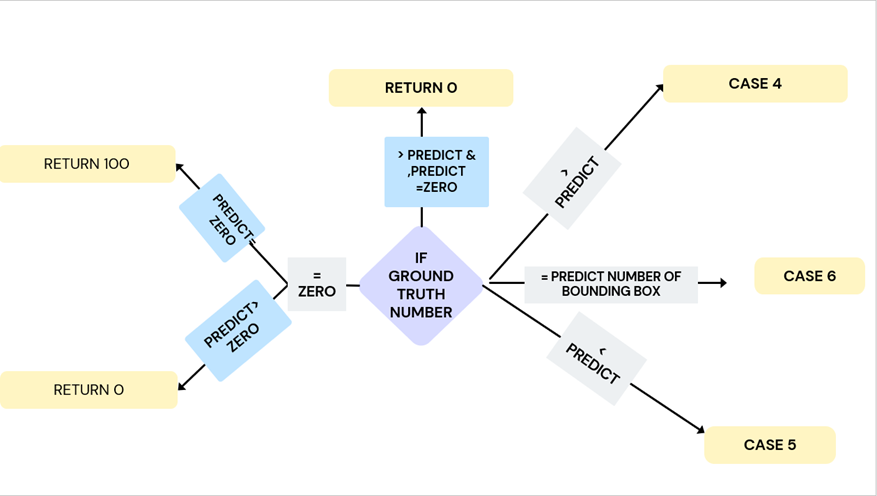


* CASE 1 BOTH GROUND TRUTH AND PREDICTED BOXES ARE EMPTY: returns a score of
100, signifying a frame without detected objects and devoid of ground truth annotations.
* CASE 2 NO GROUND TRUTH, BUT PREDICTED BOXES EXIST: yields a score of 0, indicating object detection by the model without available ground truth annotations for comparison.
* CASE 3 GROUND TRUTH EXISTS, BUT NO PREDICTED BOXES: returns a score of 0, indicating the model's failure to detect objects despite ground truth annotations.
* CASE 4 GROUND TRUTH(GT) ARE MORE THAN THE PREDICTED BOXES: calculates the best iou for each gt box against all predicted boxes and gather them in list and get the summation then divide it by the number of gt boxes.


NOTE:: calculates the best iou for each gt box because the input might not be sorted, which means that the predicted objects are not sorted as same as the ground truth objects. also divide it by the number of gt boxes here is essential because the this will decrease the iou because of missing some objects.
* CASE 5 GROUND TRUTH(GT) ARE LESS THAN THE PREDICTED BOXES: calculates the best iou for each predicted box against all gt boxes and gather them in list and get the summation then divide it by the number of predicted boxes.
* CASE 6 ALIGNED GROUND TRUTH AND PREDICTED BOXES WITH THE SAME COUNTS: computes iou for each predicted box against all ground truth boxes then get the average.



This comprehensive analysis aims to understand thе performance, accuracy, and robustness of thе different YOLOv8 models, their customized variants, learning rates, and tracking mechanisms under varying scenarios, laying thе groundwork for detailed discussions and insights into model performance in subsequent study sections.








The code creates a Pandas Series (y_valid_xywh) from the output of apply_bbox_to_y_valid(y_valid), which likely contains transformed bounding box data organized in a nested list structure.

In [ ]:
y_valid_xywh = pd.Series(apply_bbox_to_y_valid(y_valid))

# Display the resulting Pandas Series
print(y_valid_xywh)


0       [[93.5, 119.5, 19, 15]]
1       [[92.5, 119.5, 19, 15]]
2       [[92.0, 119.5, 20, 15]]
3       [[91.0, 119.5, 22, 15]]
4       [[90.0, 119.5, 26, 15]]
                 ...           
359    [[102.0, 131.5, 46, 27]]
360     [[99.5, 130.5, 47, 25]]
361     [[96.5, 130.5, 49, 25]]
362     [[94.0, 129.5, 50, 23]]
363     [[91.5, 128.5, 51, 23]]
Length: 364, dtype: object


In [ ]:
# Create the directory
os.makedirs('/content/Track', exist_ok=True)

In [ ]:
image_folder = '/content/drive/MyDrive/CV/data/images/valid'
video_name = f'/content/Track/Input_track.avi'

images = [img for img in os.listdir(image_folder) if img.endswith(".jpg")]
frame = cv2.imread(os.path.join(image_folder, images[0]))

# Set the frame width, height width
# the width, height of first image
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'DIVX'), 1, (width, height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()

##Nano Version

####0.05 Learning Rate

In [ ]:
track_video="track"
tracker="botsort.yaml"
n_05_botsort_iou=Tracking ("train","track",tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track"
tracker="bytetrack.yaml"
n_05_bytetrack_iou=Tracking ("train",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)




####0.01 Learning Rate

In [ ]:
track_video="track2"
tracker="botsort.yaml"
n_01_botsort_iou=Tracking ("train2",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track2"
tracker="bytetrack.yaml"
n_01_bytetrack_iou=Tracking ("train2",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


####0.001 Learning Rate

In [ ]:
track_video="track3"
tracker="botsort.yaml"
n_001_botsort_iou=Tracking ("train3",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track3"
tracker="bytetrack.yaml"
n_001_bytetrack_iou=Tracking ("train3",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


##Small Version

####0.05 Learning Rate

In [ ]:
track_video="track4"
tracker="botsort.yaml"
s_05_botsort_iou=Tracking ("train4",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track4"
tracker="bytetrack.yaml"
s_05_bytetrack_iou=Tracking ("train4",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


####0.01 Learning Rate

In [ ]:
track_video="track5"
tracker="botsort.yaml"
s_01_botsort_iou=Tracking ("train5",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track5"
tracker="bytetrack.yaml"
s_01_bytetrack_iou=Tracking ("train5",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


####0.001 Learning Rate

In [ ]:
track_video="track6"
tracker="botsort.yaml"
s_001_botsort_iou=Tracking ("train6",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track6"
tracker="bytetrack.yaml"
s_001_bytetrack_iou=Tracking ("train6",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


#Fixed Yaml

Thе YOLOv8 backbone describes thе layer sequences used for feature extraction. This consists of convolutional layers, C2f (a custom layer), and SPPF (Spatial Pyramid Pooling). In thе customized YOLOv8s model, two additional layers have been introduced after thе SPPF layer, marked in Figure [11]. Thеsе extra layers can facilitate improved feature extraction, aiding thе model in detecting more complex patterns.

Thе YOLOv8 had is responsible for thе final output generation. It involves a series of operations such as up sampling, concatenation with backbone layers, convolutional layers, and detection. In thе YOLOv8s model, thеrе are additional C2f layers after concatenation with P3, P4, and P5 backbone, enhancing feature еxtraction at multiple scales.
Overall, Thеsе additional layers and modifications within thе YOLOv8s model aim to enrich thе feature representation, potentially improving thе model’s ability to detect and classify objects effectively. During thе detection process, objects are identified with a confidence threshold set at >70%.


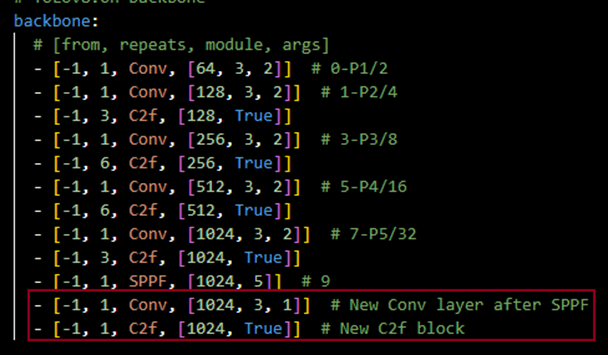

##Detection

Upload Yolov8n_fixed.yaml

In [ ]:
for rate in LearningRate:
    result = Detection_train('/content/Yolov8n_fixed.yaml', rate)
    yolo_list.append(result)

WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180

100%|██████████| 755k/755k [00:00<00:00, 14.9MB/s]

Overriding model.yaml nc=80 with nc=1
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]       

 23                  -1  1   1969152  ultralytics.nn.modules.block.C2f             [768, 512, 1]                 
 24        [15, 18, 21]  1   3740371  ultralytics.nn.modules.head.Detect           [1, [256, 128, 256]]          
Yolov8n_fixed summary: 243 layers, 17023859 parameters, 17023843 gradients, 45.9 GFLOPs

TensorBoard: Start with 'tensorboard --logdir runs/detect/train', view at http://localhost:6006/
Freezing layer 'model.24.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...


100%|██████████| 6.23M/6.23M [00:00<00:00, 73.4MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 62 weight(decay=0.0), 69 weight(decay=0.0005), 68 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      4.72G      3.616      4.064      4.135         29        640: 100%|██████████| 46/46 [00:09<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.38it/s]

                   all        364        675   0.000586     0.0948    0.00186   0.000464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      4.81G      3.151      3.313       3.51         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.04it/s]

                   all        364        675    0.00226      0.366     0.0195    0.00436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      4.82G      2.742       3.05      3.075         18        640: 100%|██████████| 46/46 [00:05<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.94it/s]

                   all        364        675     0.0964       0.16     0.0481     0.0163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      4.82G      2.582      2.916      2.859         41        640: 100%|██████████| 46/46 [00:05<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.95it/s]

                   all        364        675      0.106      0.123     0.0492     0.0206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      4.82G      2.405      2.736      2.727         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.00it/s]

                   all        364        675      0.239        0.2      0.149     0.0623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      4.81G      2.235      2.464      2.556         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.34it/s]

                   all        364        675      0.281      0.236      0.213     0.0972



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40       4.8G      2.052      2.301      2.423         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.93it/s]

                   all        364        675      0.343      0.365      0.286      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40       4.8G      1.972      2.134      2.285         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.26it/s]

                   all        364        675      0.425      0.185      0.179      0.086



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      4.81G      1.922       2.09      2.264         48        640: 100%|██████████| 46/46 [00:05<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.23it/s]

                   all        364        675      0.433      0.403      0.366      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      4.81G      1.834      1.986      2.182         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.46it/s]

                   all        364        675      0.443      0.245      0.248      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      4.83G      1.757       1.86      2.094         21        640: 100%|██████████| 46/46 [00:06<00:00,  7.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.31it/s]

                   all        364        675      0.561      0.458      0.459       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      4.82G      1.736      1.806      2.091         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.46it/s]

                   all        364        675      0.572      0.499       0.53      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      4.84G      1.632      1.712      1.994         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.54it/s]

                   all        364        675      0.601      0.572      0.557       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40       4.8G      1.589      1.628      1.954         23        640: 100%|██████████| 46/46 [00:05<00:00,  7.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.95it/s]

                   all        364        675      0.568      0.575      0.565      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      4.82G       1.55      1.657      1.933         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.548      0.535      0.547      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40       4.8G      1.527      1.565      1.886         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.32it/s]

                   all        364        675       0.63      0.555      0.599        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      4.81G      1.448      1.479      1.805         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.622      0.646      0.655      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40       4.8G      1.467      1.453      1.822         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.47it/s]

                   all        364        675      0.641       0.64      0.661      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      4.81G      1.485      1.459      1.835         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.28it/s]

                   all        364        675      0.644      0.599      0.614      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40       4.8G      1.411      1.397      1.773         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675      0.677      0.674      0.714      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      4.82G      1.376      1.346      1.756         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.59it/s]

                   all        364        675        0.7      0.655      0.694       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      4.81G      1.346      1.334      1.731         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.48it/s]

                   all        364        675      0.637      0.677      0.673      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      4.82G      1.315       1.28      1.682         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.741      0.619      0.732      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      4.81G       1.27      1.234      1.654         34        640: 100%|██████████| 46/46 [00:05<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.672       0.67      0.704      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      4.81G      1.261      1.231      1.644         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.48it/s]

                   all        364        675      0.725      0.695       0.74       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40       4.8G      1.239      1.153      1.613         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.54it/s]

                   all        364        675      0.708      0.737      0.763      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      4.81G      1.196      1.105      1.577         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.35it/s]

                   all        364        675      0.761      0.686      0.747      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40       4.8G      1.176      1.129      1.568         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.61it/s]

                   all        364        675       0.73      0.705      0.751      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      4.82G      1.155      1.093      1.549         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.39it/s]

                   all        364        675       0.73      0.733      0.789      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40       4.8G      1.137      1.042      1.546         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.64it/s]

                   all        364        675      0.784      0.746      0.797      0.601


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      4.82G      1.045     0.9914      1.505         19        640: 100%|██████████| 46/46 [00:07<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.64it/s]

                   all        364        675      0.793      0.708      0.795      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      4.81G     0.9859     0.9031      1.456         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.47it/s]

                   all        364        675      0.796      0.754      0.808       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      4.81G     0.9583     0.8634      1.445         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.771      0.752      0.808      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40       4.8G      0.944      0.828      1.431         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.59it/s]

                   all        364        675      0.848       0.73       0.84      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40       4.8G     0.9025     0.8031      1.386         16        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.846       0.76      0.849      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      4.81G     0.9042     0.7895      1.378         14        640: 100%|██████████| 46/46 [00:05<00:00,  8.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.59it/s]

                   all        364        675      0.828      0.757      0.845       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      4.81G     0.8959     0.7645       1.37         16        640: 100%|██████████| 46/46 [00:05<00:00,  7.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675      0.798      0.784      0.842      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      4.81G     0.8705     0.7424      1.348         13        640: 100%|██████████| 46/46 [00:05<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.43it/s]

                   all        364        675      0.845      0.769      0.844      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40       4.8G     0.8409     0.6976      1.339         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.60it/s]

                   all        364        675      0.837       0.76      0.846      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      4.81G     0.8208     0.6848      1.321         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.49it/s]

                   all        364        675      0.835      0.794       0.86      0.692



40 epochs completed in 0.104 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 34.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 34.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Yolov8n_fixed summary (fused): 181 layers, 17011027 parameters, 0 gradients, 45.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.79it/s]


                   all        364        675      0.836      0.794       0.86      0.693
Speed: 0.2ms preprocess, 1.6ms inference, 0.0ms loss, 4.6ms postprocess per image
Results saved to runs/detect/train
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.mo

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 62 weight(decay=0.0), 69 weight(decay=0.0005), 68 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train2
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      5.04G      3.616      4.064      4.135         29        640: 100%|██████████| 46/46 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675   0.000586     0.0948    0.00186   0.000464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      5.14G      3.151      3.313       3.51         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.17it/s]

                   all        364        675    0.00226      0.366     0.0195    0.00436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      5.14G      2.742       3.05      3.075         18        640: 100%|██████████| 46/46 [00:05<00:00,  7.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.99it/s]

                   all        364        675     0.0964       0.16     0.0481     0.0163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      5.13G      2.582      2.916      2.859         41        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.15it/s]

                   all        364        675      0.106      0.123     0.0492     0.0206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      5.13G      2.405      2.736      2.727         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.22it/s]

                   all        364        675      0.239        0.2      0.149     0.0623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      5.14G      2.235      2.464      2.556         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.27it/s]

                   all        364        675      0.281      0.236      0.213     0.0972



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      5.13G      2.052      2.301      2.423         26        640: 100%|██████████| 46/46 [00:05<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.42it/s]

                   all        364        675      0.343      0.365      0.286      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      5.14G      1.972      2.134      2.285         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675      0.425      0.185      0.179      0.086



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      5.13G      1.922       2.09      2.264         48        640: 100%|██████████| 46/46 [00:05<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.35it/s]

                   all        364        675      0.433      0.403      0.366      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      5.13G      1.834      1.986      2.182         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.443      0.245      0.248      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      5.13G      1.757       1.86      2.094         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.561      0.458      0.459       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      5.12G      1.736      1.806      2.091         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675      0.572      0.499       0.53      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      5.14G      1.632      1.712      1.994         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.28it/s]

                   all        364        675      0.601      0.572      0.557       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      5.13G      1.589      1.628      1.954         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.55it/s]

                   all        364        675      0.568      0.575      0.565      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      5.14G       1.55      1.657      1.933         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.44it/s]

                   all        364        675      0.548      0.535      0.547      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      5.13G      1.527      1.565      1.886         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675       0.63      0.555      0.599        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      5.13G      1.448      1.479      1.805         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.622      0.646      0.655      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      5.12G      1.467      1.453      1.822         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]

                   all        364        675      0.641       0.64      0.661      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      5.14G      1.485      1.459      1.835         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.48it/s]

                   all        364        675      0.644      0.599      0.614      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      5.13G      1.411      1.397      1.773         25        640: 100%|██████████| 46/46 [00:06<00:00,  7.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.677      0.674      0.714      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      5.12G      1.376      1.346      1.756         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675        0.7      0.655      0.694       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      5.13G      1.346      1.334      1.731         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.66it/s]

                   all        364        675      0.637      0.677      0.673      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      5.13G      1.315       1.28      1.682         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.36it/s]

                   all        364        675      0.741      0.619      0.732      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      5.13G       1.27      1.234      1.654         34        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.59it/s]

                   all        364        675      0.672       0.67      0.704      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      5.15G      1.261      1.231      1.644         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        364        675      0.725      0.695       0.74       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      5.13G      1.239      1.153      1.613         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.47it/s]

                   all        364        675      0.708      0.737      0.763      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      5.13G      1.196      1.105      1.577         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.761      0.686      0.747      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      5.14G      1.176      1.129      1.568         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.49it/s]

                   all        364        675       0.73      0.705      0.751      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      5.15G      1.155      1.093      1.549         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675       0.73      0.733      0.789      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      5.14G      1.137      1.042      1.546         27        640: 100%|██████████| 46/46 [00:05<00:00,  8.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.59it/s]

                   all        364        675      0.784      0.746      0.797      0.601


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      5.13G      1.045     0.9914      1.505         19        640: 100%|██████████| 46/46 [00:07<00:00,  6.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.51it/s]

                   all        364        675      0.793      0.708      0.795      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      5.13G     0.9859     0.9031      1.456         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.796      0.754      0.808       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      5.14G     0.9583     0.8634      1.445         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.60it/s]

                   all        364        675      0.771      0.752      0.808      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      5.14G      0.944      0.828      1.431         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.66it/s]

                   all        364        675      0.848       0.73       0.84      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      5.13G     0.9025     0.8031      1.386         16        640: 100%|██████████| 46/46 [00:05<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.38it/s]

                   all        364        675      0.846       0.76      0.849      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      5.13G     0.9042     0.7895      1.378         14        640: 100%|██████████| 46/46 [00:05<00:00,  7.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.21it/s]

                   all        364        675      0.828      0.757      0.845       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      5.13G     0.8959     0.7645       1.37         16        640: 100%|██████████| 46/46 [00:05<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.28it/s]

                   all        364        675      0.798      0.784      0.842      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      5.12G     0.8705     0.7424      1.348         13        640: 100%|██████████| 46/46 [00:05<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.48it/s]

                   all        364        675      0.845      0.769      0.844      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      5.14G     0.8409     0.6976      1.339         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.837       0.76      0.846      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      5.13G     0.8208     0.6848      1.321         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        364        675      0.835      0.794       0.86      0.692



40 epochs completed in 0.102 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 34.3MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 34.3MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Yolov8n_fixed summary (fused): 181 layers, 17011027 parameters, 0 gradients, 45.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.82it/s]


                   all        364        675      0.836      0.794       0.86      0.693
Speed: 0.3ms preprocess, 5.0ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train2
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.m

train: Scanning /content/drive/MyDrive/CV/data/labels/train.cache... 730 images, 0 backgrounds, 0 corrupt: 100%|██████████| 730/730 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CV/data/labels/valid.cache... 364 images, 0 backgrounds, 0 corrupt: 100%|██████████| 364/364 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 62 weight(decay=0.0), 69 weight(decay=0.0005), 68 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train3
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      5.38G      3.616      4.064      4.135         29        640: 100%|██████████| 46/46 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.35it/s]

                   all        364        675   0.000586     0.0948    0.00186   0.000464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      5.46G      3.151      3.313       3.51         32        640: 100%|██████████| 46/46 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.84it/s]

                   all        364        675    0.00226      0.366     0.0195    0.00436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      5.47G      2.742       3.05      3.075         18        640: 100%|██████████| 46/46 [00:05<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.89it/s]

                   all        364        675     0.0964       0.16     0.0481     0.0163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      5.44G      2.582      2.916      2.859         41        640: 100%|██████████| 46/46 [00:05<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.12it/s]

                   all        364        675      0.106      0.123     0.0492     0.0206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      5.46G      2.405      2.736      2.727         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.23it/s]

                   all        364        675      0.239        0.2      0.149     0.0623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      5.44G      2.235      2.464      2.556         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.39it/s]

                   all        364        675      0.281      0.236      0.213     0.0972



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      5.48G      2.052      2.301      2.423         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.24it/s]

                   all        364        675      0.343      0.365      0.286      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      5.44G      1.972      2.134      2.285         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.12it/s]

                   all        364        675      0.425      0.185      0.179      0.086



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      5.47G      1.922       2.09      2.264         48        640: 100%|██████████| 46/46 [00:05<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.13it/s]

                   all        364        675      0.433      0.403      0.366      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      5.44G      1.834      1.986      2.182         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675      0.443      0.245      0.248      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      5.46G      1.757       1.86      2.094         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.10it/s]

                   all        364        675      0.561      0.458      0.459       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      5.45G      1.736      1.806      2.091         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.23it/s]

                   all        364        675      0.572      0.499       0.53      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      5.47G      1.632      1.712      1.994         29        640: 100%|██████████| 46/46 [00:05<00:00,  7.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675      0.601      0.572      0.557       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      5.44G      1.589      1.628      1.954         23        640: 100%|██████████| 46/46 [00:05<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.44it/s]

                   all        364        675      0.568      0.575      0.565      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      5.46G       1.55      1.657      1.933         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.31it/s]

                   all        364        675      0.548      0.535      0.547      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      5.45G      1.527      1.565      1.886         31        640: 100%|██████████| 46/46 [00:05<00:00,  7.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.40it/s]

                   all        364        675       0.63      0.555      0.599        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      5.47G      1.448      1.479      1.805         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.24it/s]

                   all        364        675      0.622      0.646      0.655      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      5.44G      1.467      1.453      1.822         32        640: 100%|██████████| 46/46 [00:05<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.35it/s]

                   all        364        675      0.641       0.64      0.661      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      5.46G      1.485      1.459      1.835         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.32it/s]

                   all        364        675      0.644      0.599      0.614      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      5.44G      1.411      1.397      1.773         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.677      0.674      0.714      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      5.47G      1.376      1.346      1.756         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.68it/s]

                   all        364        675        0.7      0.655      0.694       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      5.44G      1.346      1.334      1.731         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.60it/s]

                   all        364        675      0.637      0.677      0.673      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      5.47G      1.315       1.28      1.682         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.53it/s]

                   all        364        675      0.741      0.619      0.732      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      5.44G       1.27      1.234      1.654         34        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.43it/s]

                   all        364        675      0.672       0.67      0.704      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      5.46G      1.261      1.231      1.644         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.61it/s]

                   all        364        675      0.725      0.695       0.74       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      5.44G      1.239      1.153      1.613         32        640: 100%|██████████| 46/46 [00:05<00:00,  8.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.708      0.737      0.763      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      5.46G      1.196      1.105      1.577         26        640: 100%|██████████| 46/46 [00:05<00:00,  7.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.54it/s]

                   all        364        675      0.761      0.686      0.747      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      5.44G      1.176      1.129      1.568         31        640: 100%|██████████| 46/46 [00:05<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.27it/s]

                   all        364        675       0.73      0.705      0.751      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      5.47G      1.155      1.093      1.549         24        640: 100%|██████████| 46/46 [00:05<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.66it/s]

                   all        364        675       0.73      0.733      0.789      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      5.44G      1.137      1.042      1.546         27        640: 100%|██████████| 46/46 [00:05<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        364        675      0.784      0.746      0.797      0.601


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      5.46G      1.045     0.9914      1.505         19        640: 100%|██████████| 46/46 [00:07<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.41it/s]

                   all        364        675      0.793      0.708      0.795      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      5.44G     0.9859     0.9031      1.456         21        640: 100%|██████████| 46/46 [00:05<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]

                   all        364        675      0.796      0.754      0.808       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      5.46G     0.9583     0.8634      1.445         23        640: 100%|██████████| 46/46 [00:05<00:00,  8.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.47it/s]

                   all        364        675      0.771      0.752      0.808      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      5.45G      0.944      0.828      1.431         20        640: 100%|██████████| 46/46 [00:05<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.44it/s]

                   all        364        675      0.848       0.73       0.84      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      5.46G     0.9025     0.8031      1.386         16        640: 100%|██████████| 46/46 [00:05<00:00,  7.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.61it/s]

                   all        364        675      0.846       0.76      0.849      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      5.45G     0.9042     0.7895      1.378         14        640: 100%|██████████| 46/46 [00:05<00:00,  7.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.40it/s]

                   all        364        675      0.828      0.757      0.845       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      5.47G     0.8959     0.7645       1.37         16        640: 100%|██████████| 46/46 [00:05<00:00,  7.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.50it/s]

                   all        364        675      0.798      0.784      0.842      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      5.45G     0.8705     0.7424      1.348         13        640: 100%|██████████| 46/46 [00:05<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.52it/s]

                   all        364        675      0.845      0.769      0.844      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      5.47G     0.8409     0.6976      1.339         21        640: 100%|██████████| 46/46 [00:05<00:00,  8.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.44it/s]

                   all        364        675      0.837       0.76      0.846      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      5.45G     0.8208     0.6848      1.321         25        640: 100%|██████████| 46/46 [00:05<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.42it/s]

                   all        364        675      0.835      0.794       0.86      0.692



40 epochs completed in 0.103 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 34.3MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 34.3MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.0.221 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Yolov8n_fixed summary (fused): 181 layers, 17011027 parameters, 0 gradients, 45.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.84it/s]


                   all        364        675      0.836      0.794       0.86      0.693
Speed: 0.1ms preprocess, 2.5ms inference, 0.0ms loss, 5.0ms postprocess per image
Results saved to runs/detect/train3


####0.05 Learning Rate

In [ ]:
n_05 = yolo_list[6]    #-->train

In [ ]:
video_train7=Detection ("train7","detect7")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train7)


####0.01 Learning Rate

In [ ]:
n_06 = yolo_list[7]    #-->train

In [ ]:
video_train8=Detection ("train8","detect8")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train8)


####0.001 Learning Rate

In [ ]:
n_07 = yolo_list[8]    #-->train

In [ ]:
video_train9=Detection ("train9","detect9")

# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % video_train9)


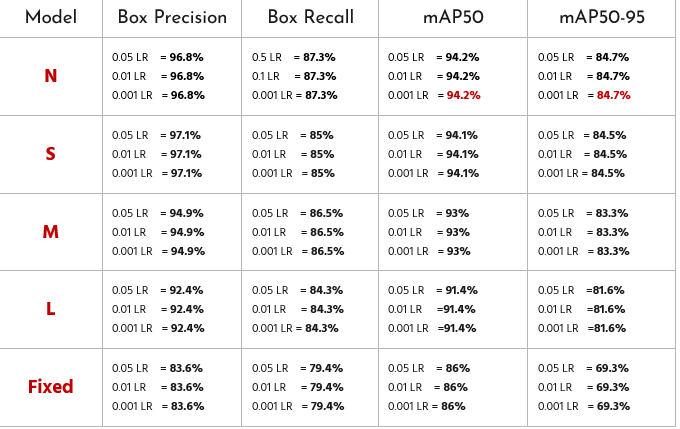

Champion Model is Yolov8n-->0.01 LR


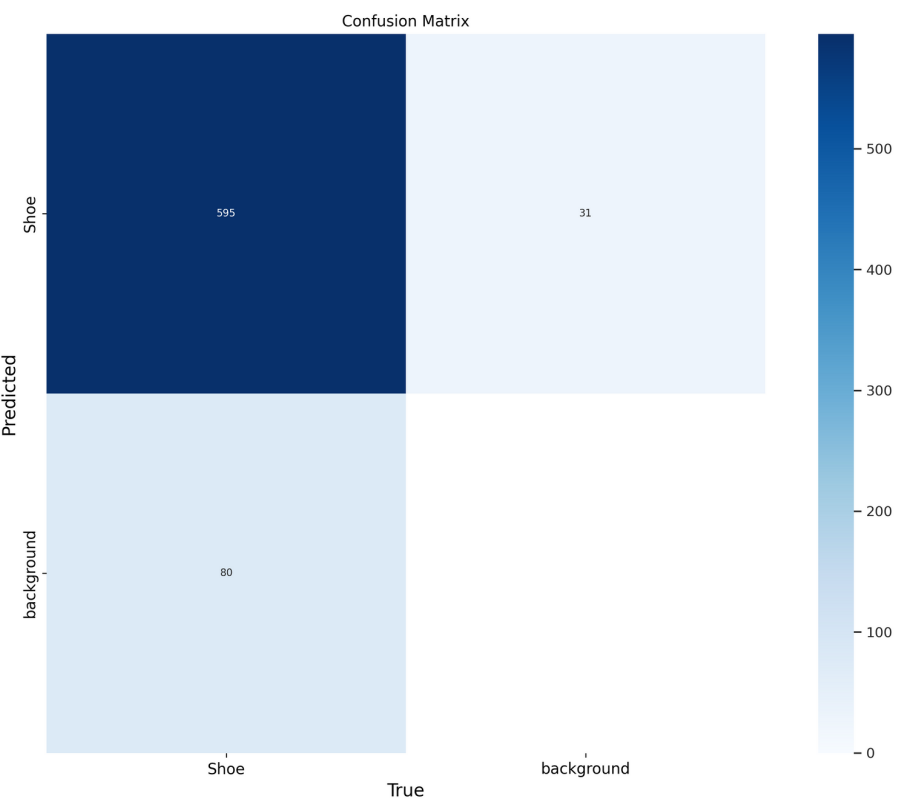


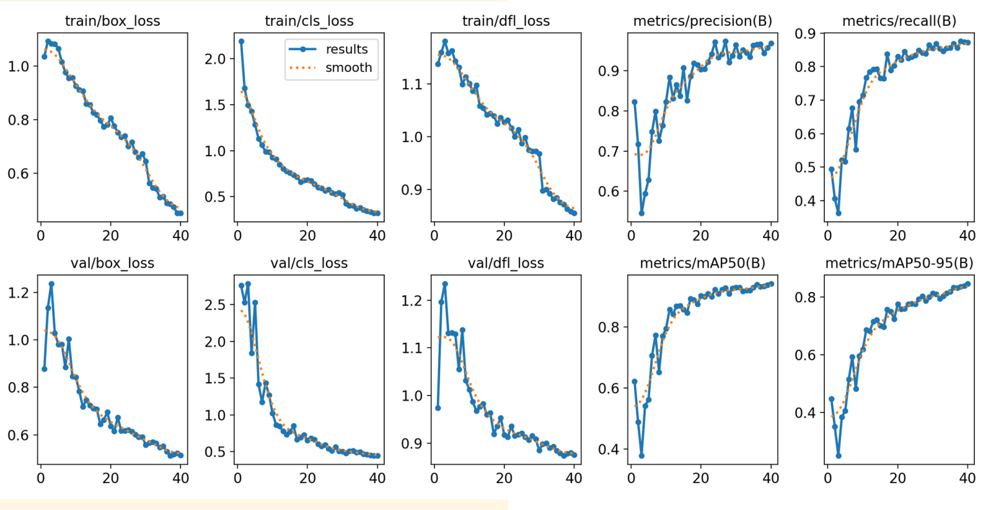



##Tracking

####0.05 Learning Rate

In [ ]:
track_video="track7"
tracker="botsort.yaml"
sf_05_botsort_iou=Tracking ("train7","track",tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track7"
tracker="bytetrack.yaml"
sf_05_bytetrack_iou=Tracking ("train7",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


####0.01 Learning Rate

In [ ]:
track_video="track8"
tracker="botsort.yaml"
sf_01_botsort_iou=Tracking ("train8",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track8"
tracker="bytetrack.yaml"
sf_01_bytetrack_iou=Tracking ("train8",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


####0.001 Learning Rate

In [ ]:
track_video="track9"
tracker="botsort.yaml"
sf_001_botsort_iou=Tracking ("train9",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [ ]:
track_video="track9"
tracker="bytetrack.yaml"
sf_001_bytetrack_iou=Tracking ("train9",track_video,tracker)

# Run ffmpeg command to convert the video
ffmpeg_cmd = f"ffmpeg -i /content/Track/{track_video}{tracker}_output_video.avi -vf setpts=5.0*PTS -vcodec libx264 /content/Track/{track_video}{tracker}_output_video.mp4"

subprocess.run(ffmpeg_cmd, shell=True)

# Read the converted MP4 file
mp4 = open(f'/content/Track/{track_video}{tracker}_output_video.mp4', 'rb').read()
# Create data URL for HTML video tag
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# Display the HTML video tag with increased width and height
HTML("""
<video width="800" height="600" controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


#Evaluation

Thе еvaluation of trackеrs BotSort and BytеTrackеr is rooted in thе Intеrsеction ovеr Union (IoU) pеrformancе mеtric, which gaugеs thе prеcision of objеct localization. Thе IoU is mathematically defined as:

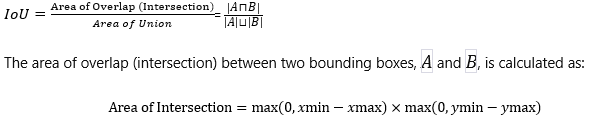


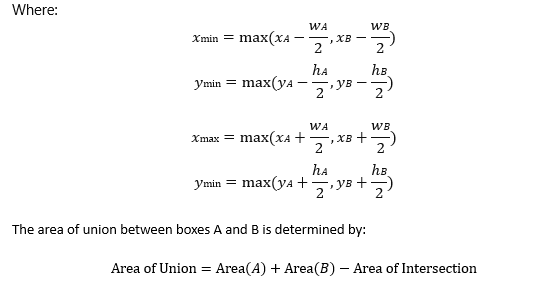



Utilizing IoU as thе primary еvaluation mеtric offers insight into thе prе2cision of objеct dеtеction and localization for thе BotSort and BytеTrackеr, supporting robust assеssmеnt and comparison between prеdictеd and actual objеct bounding boxеs in tracking scenarios.

In [ ]:
# Data for 'YOLOv8n'
data_yolov8n = {
    'BoT-SORT':  [n_05_botsort_iou, n_01_botsort_iou, n_001_botsort_iou],
    'ByteTrack': [n_05_bytetrack_iou, n_01_bytetrack_iou, n_001_bytetrack_iou]
}

# Data for 'YOLOv8s'
data_yolov8s = {
    'BoT-SORT': [s_01_botsort_iou, s_05_botsort_iou, s_001_botsort_iou],
    'ByteTrack': [s_05_bytetrack_iou, s_01_bytetrack_iou, s_001_bytetrack_iou]
}

# Data for 'YOLOv8_Fixed'
data_yolov8sf = {
    'BoT-SORT': [sf_01_botsort_iou, sf_05_botsort_iou, sf_001_botsort_iou],
    'ByteTrack': [sf_05_bytetrack_iou, sf_01_bytetrack_iou, sf_001_bytetrack_iou]
}

# Index for rows
index_rows = ['0.05', '0.01', '0.001']

# Creating DataFrames
yolov8n_df = pd.DataFrame(data_yolov8n, index=index_rows)
yolov8s_df = pd.DataFrame(data_yolov8s, index=index_rows)
yolov8sf_df = pd.DataFrame(data_yolov8sf, index=index_rows)

In [ ]:
print("DataFrame for YOLOv8n:")
yolov8n_df.style.background_gradient(cmap='Blues')


DataFrame for YOLOv8n:


,BoT-SORT,ByteTrack
0.05,77.545472,67.285452
0.01,77.545472,67.285452
0.001,77.545472,67.285452


In [ ]:
print("\nDataFrame for YOLOv8s:")
yolov8s_df.style.background_gradient(cmap='Blues')



DataFrame for YOLOv8s:


,BoT-SORT,ByteTrack
0.05,66.361091,76.780715
0.01,66.361091,76.780715
0.001,66.361091,76.780715


In [ ]:
print("DataFrame for YOLOv8sf:")
yolov8sf_df.style.background_gradient(cmap='Blues')

DataFrame for YOLOv8sf:


,BoT-SORT,ByteTrack
0.05,65.213060,56.650867
0.01,65.213060,56.650867
0.001,65.213060,56.650867


1. YOLO isn't inherently a tracker; it serves as a detector with incorporated algorithms such as BoT-SORT Tracker and ByteTrack Tracker for tracking. This integration stems from YOLO's capability to swiftly and effectively detect objects while maintaining high performance levels.

2. The evaluation of trackers indicates a limited sensitivity to learning rate adjustments, suggesting that other parameters might overshadow the impact of changes in the learning rate.

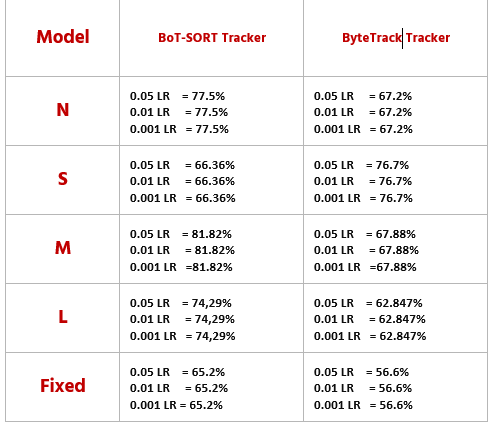

# CONCLUSION & Future Works

1. **Choosing Other Parameters than Learning Rate:** In machine learning models, the learning rate is a crucial hyperparameter that affects how quickly a model learns from data. However, in some cases, tweaking other parameters (such as batch size, optimizer choice, regularization techniques) apart from the learning rate might have a more significant impact on the model's performance. This approach involves experimenting with and adjusting various parameters other than the learning rate to improve the model's training process or performance.

2. **Reducing Model Complexity:** Complex models might lead to overfitting or computational inefficiency. Lowering the complexity of a model involves simplifying its architecture by reducing the number of layers, neurons, or parameters. This process aims to create a more streamlined, easier-to-understand model that can generalize better to unseen data and potentially improve its performance.

3. **Increasing Data Importance:** In machine learning, the quantity and quality of data play a crucial role in training robust models. Increasing the dataset size can help in understanding how a model reacts or generalizes to diverse scenarios. By providing more varied and representative data, one can assess how the model performs across different conditions, potentially improving its accuracy and generalization capabilities.

Each of these strategies aims to optimize different aspects of the machine learning process to enhance the model's performance, generalization, or training efficiency. Adjusting parameters beyond the learning rate, simplifying model complexity, and enriching the dataset are all methods to iteratively improve the model's capabilities and effectiveness.

#REFERENCES

1.   G. Jocher, “YOLOv8 Documentation,” docs.ultralytics.com, May 18, 2020.
https://docs.ultralytics.com/
2. J. Fan et al., "A Research on CSR-DCF Tracking Algorithm based on YOLO Detection," 2023 4th International
Conference on Computer Vision, Image and Deep Learning (CVIDL), Zhuhai, China, 2023, pp. 641-645, doi: 10.1109/CVIDL58838.2023.10166988.
3. J. Qu and S. Zhang, "Research on Video Tracking Algorithm Based on Yolo Target Detection," 2023 6th
International Conference on Computer Network, Electronic and Automation (ICCNEA), Xi’an, China, 2023, pp.
437-439, doi: 10.1109/ICCNEA60107.2023.00098.
4. Heet Thakkar, Noopur Tambe, Sanjana Thamke, Prof. Vaishali K. Gaidhane, "Object Tracking by detection
using YOLO and SORT", International Journal of Scientific Research in Computer Science, Engineering and
Information Technology (IJSRCSEIT), Maharashtra, India, 2020, pp. 224-229, doi: 10.32628/CSEIT206256.
5. Jocher, Glenn, et al. “YOLO by Ultralytics.” GitHub, 1 Jan. 2023, github.com/ultralytics/ultralytics.
6.  J. Solawetz and Francesco, “What is YOLOv8? The Ultimate Guide.,” Roboflow Blog, Jan. 11, 2023.https://blog.roboflow.com/whats-new-in-yolov8